# Learning Gradients of Convex Functions with Monotone Gradient Networks
Implementation of the article by Chaudhari et al. (2023) [1]

In [26]:
# import dependencies 
import torch.nn as nn
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import random

## 1. Monotone Gradient Networks and ICGN
We implement different architectures:
- C-MGN and M-MGN presented in the paper [1]
- Input Convex Gradient Network (ICGN) from Richter-Powell et al. (2021)

In [27]:
class CMGN(nn.Module):
    def __init__(self, input_dim, output_dim, num_layers, hidden_dim):
        super(CMGN, self).__init__()
        self.num_layers = num_layers
        self.sigma_layers = nn.ModuleList([nn.Sigmoid() for _ in range(num_layers)])
        self.biases = nn.ParameterList([nn.Parameter(torch.randn(hidden_dim)) for _ in range(num_layers)])
        self.W = nn.Parameter(torch.randn(input_dim, hidden_dim)) # Share the weight matrix W across all layers
        self.V = nn.Parameter(torch.randn(hidden_dim, input_dim))
        self.bL = nn.Parameter(torch.randn(output_dim))

    def forward(self, x):

        Wx = F.linear(x, self.W)
        z = Wx + self.biases[0] 
        for i in range(1,self.num_layers):
            z = Wx + self.sigma_layers[i-1](z) + self.biases[i]

        VTx = F.linear(x, self.V.t())
        VTVx = F.linear(VTx, self.V)
        Wsigma = F.linear(self.sigma_layers[self.num_layers-1](z), self.W.T)

        output = Wsigma + VTVx + self.bL
        return output

# Example usage:
input_dim = 2
output_dim = 2
num_layers =2
hidden_dim = 2

model = CMGN(input_dim, output_dim, num_layers, hidden_dim)
print(model)

CMGN(
  (sigma_layers): ModuleList(
    (0-1): 2 x Sigmoid()
  )
  (biases): ParameterList(
      (0): Parameter containing: [torch.float32 of size 2]
      (1): Parameter containing: [torch.float32 of size 2]
  )
)


In [28]:
def count_parameters(model: torch.nn.Module) -> int:
  """ Counts the number of trainable parameters of a module
  :param model: model that contains the parameters to count
  :returns: the number of parameters in the model
  """
  return sum(p.numel() for p in model.parameters() if p.requires_grad)

def visualize_layers(model: torch.nn.Module):
    """ Visualize layers and components and
    number of parameters for each """
    for name, param in model.named_parameters():
        if param.requires_grad:
            print(name, param.shape)

def summary_model(model: torch.nn.Module):
    print('Number of parameters:', count_parameters(model))
    print('Layers:')
    visualize_layers(model)


summary_model(model)

Number of parameters: 14
Layers:
W torch.Size([2, 2])
V torch.Size([2, 2])
bL torch.Size([2])
biases.0 torch.Size([2])
biases.1 torch.Size([2])


In [29]:
class MMGN(nn.Module):
    def __init__(self, input_dim, output_dim, num_modules, hidden_dim):
        super(MMGN, self).__init__()
        self.num_modules = num_modules
        self.W_list = nn.ParameterList([nn.Parameter(torch.randn(input_dim, hidden_dim)) for _ in range(num_modules)])
        self.biases = nn.ParameterList([nn.Parameter(torch.randn(hidden_dim)) for _ in range(num_modules)])
        self.activation = nn.Tanh()

        self.V = nn.Parameter(torch.randn(hidden_dim, input_dim))
        self.a = nn.Parameter(torch.randn(output_dim))

    def forward(self, x):
        def log_cosh(x):
          return torch.sum( torch.log(torch.cosh(x)) )

        sum = 0
        for i in range(self.num_modules):
            Wx = F.linear(x, self.W_list[i].T)
            z = Wx + self.biases[i]
            Wsigma = F.linear(self.activation(z), self.W_list[i])
            sum += log_cosh(z) * Wsigma
        VTx = F.linear(x, self.V)
        VTVx = F.linear(VTx, self.V.t())

        output = self.a + VTVx + sum 
        return output

# Example usage:
input_dim = 2
output_dim = 2
num_layers = 1
hidden_dim = 4

model = MMGN(input_dim, output_dim, num_layers, hidden_dim)
summary_model(model)

Number of parameters: 22
Layers:
V torch.Size([4, 2])
a torch.Size([2])
W_list.0 torch.Size([2, 4])
biases.0 torch.Size([4])


In [30]:
#models the gradient by integrating the jacobian
#justOrtho = nn.Linear
class ICGN(nn.Module):
    def __init__(self,in_dim,hidden,layers=1,ortho=1,**kwargs,):

        super(ICGN,self).__init__()

        self.hidden = hidden
        self.in_dim = in_dim
        self.out_dim = in_dim


        self.lin = nn.ModuleList([
                nn.Linear(in_dim,hidden,bias=True),
                *[nn.Linear(hidden,hidden) for _ in range(layers)],
        ])

        self.act = nn.Sigmoid()#lambda x: nn.Softplus()(x) - np.log(2)

    def jvp(self, x,v):
        with torch.enable_grad():
            #computes w = V(x)v
            w = torch.autograd.functional.jvp(self.forward_, inputs=x, v=v, create_graph=True)[1]
            #compute w = V.T(x)w
            w = torch.autograd.functional.vjp(self.forward_,inputs=x,v=w, create_graph=True)[1]
        return w


    def forward_(self,x):
        a = self.act
        y = a(self.lin[0](x))

        for lay in self.lin[1:-1]:
            y = a(lay(y))

        return self.lin[-1](y) if len(self.lin) > 1 else y

        # for lay in self.lin[1:][::-1]:
        #     y = a(F.linear(y,lay.weight.data.T))


        # return F.linear(y,self.lin[0].weight.data.T)

    def checkjac(self,simp=False,N=100):
        x = torch.rand(1,self.in_dim)
        print("computing jacobian using autograd on forward")
        if self.in_dim < 10:
            if simp:
                M = torch.autograd.functional.jacobian(self.forward_simp,inputs=x,vectorize=True).squeeze()
            else:
                M = torch.autograd.functional.jacobian(lambda x: self.forward(x,N=N),inputs=x,vectorize=True).squeeze()
            print(M)

        print("computing jacobian using autograd on forward_")
        if self.in_dim < 10:
            V = torch.autograd.functional.jacobian(self.forward_,inputs=x,vectorize=True).squeeze()
            V = V.T@V
            print(V)

        print("checking PSD")
        M.detach()
        with torch.no_grad():
            for _ in range(100):
                v = torch.rand(self.in_dim)
                if (v*M@v).sum() < -1e-2:
                    print("Failed PSD test", (v*M@v).sum(), "vector", v, "at point", x)
                    return
        print("passed psd test")
        return

    #this evaluates the PDE given in the paper, averaging over N randomly chosen points
    # the expected result (if the hidden network satisfies the PDE) is 0
    def checkPDE(self):
        pass


    #numerically computes the line integral
    def forward(self,x,N=100,**kwargs):
        pts = torch.rand(size=(N,)).reshape(1,-1,1).to(x.device)

        in_size = x.shape[0]
        in_dim = (self.in_dim,)
        out_dim = (self.out_dim,)

        z = x.unsqueeze(1) * pts
        v = x.unsqueeze(1) * torch.ones_like(pts)

        z = z.reshape(-1,*in_dim)
        v = v.reshape(-1,*in_dim)


        #this computes the integral
        y = self.jvp(z,v)
        y = y.reshape(in_size,-1,*out_dim).sum(dim=1) / N

        return y

    #uses simpsons rule for computing integral, more accurate but problematic because eval points are fixed
    #can't be used for learning because the model learns to avoid those points and do weird things
    #however, is very accurate at inference time
    def forward_simp(self,x,w=None,**kwargs):
        pts = torch.tensor([0,1/3,2/3,1]).reshape(1,-1,1).to(x.device)


        scale = torch.tensor([1,3,3,1]).reshape(1,-1,1).to(x.device)

        in_size = x.shape[0]
        in_dim = (self.in_dim,)
        out_dim = (self.out_dim,)

        z = x.unsqueeze(1) * pts
        if w is None: v = x.unsqueeze(1) * torch.ones_like(pts) #probably a better way to do this
        else: v = w.unsqueeze(1) * torch.ones_like(pts)
        #print(z.shape,v.shape)
        #not necessary for linear layers, but will be for convolutions so good practice
        z = z.reshape(-1,*in_dim)
        v = v.reshape(-1,*in_dim)

        #this computes the integral
        y = self.jvp(z,v)
        #print("after jvp", y.reshape(in_size,-1,*out_dim).shape)
        y = 1/8 * (y.reshape(in_size,-1,*out_dim)*scale).sum(dim=1)

        #print("output", y.shape)
        return y

In [31]:
model_ICGN = ICGN(in_dim=input_dim,hidden=5,layers=0, ortho=0)
summary_model(model_ICGN)

Number of parameters: 15
Layers:
lin.0.weight torch.Size([5, 2])
lin.0.bias torch.Size([5])


## 2. Gradient field experiment
We reproduce the gradient field experiment from [1]: we want to estimate the gradient field of $f: \mathbb{R}^2 \rightarrow \mathbb{R}$ such that:
\begin{equation}
f(x) = x_1^4 + \frac{x_2}{2} +  \frac{x_1 x_2}{2}  + \frac{3x_2^3}{2} -  \frac{x_2^3}{3}
\end{equation}

Models:
- C-MGN has 14 parameters as in [1]
- M-MGN has 22 parameters as in [1] 
- ICGN has 15 parameters as in [1]

Training procedure from [2]:
- 1 million points randomly sampled from the unit square
- mean absolute error loss
- batch size of 100 
- learning rate of 0.02
- Adam optimizer

In [8]:
def f(z):
  x = z[:,0]
  y = z[:,1]
  return torch.stack([x**4 + 0.5*y + 0.5 * x* y + 1.5 * y**2 - y**3/3]).T

In [9]:
def g(z):
    x = z[:,0]
    y = z[:,1]
    return torch.stack([4*x**3 + 0.5*y + x, 3*y - y**2 + 0.5*x ]).T

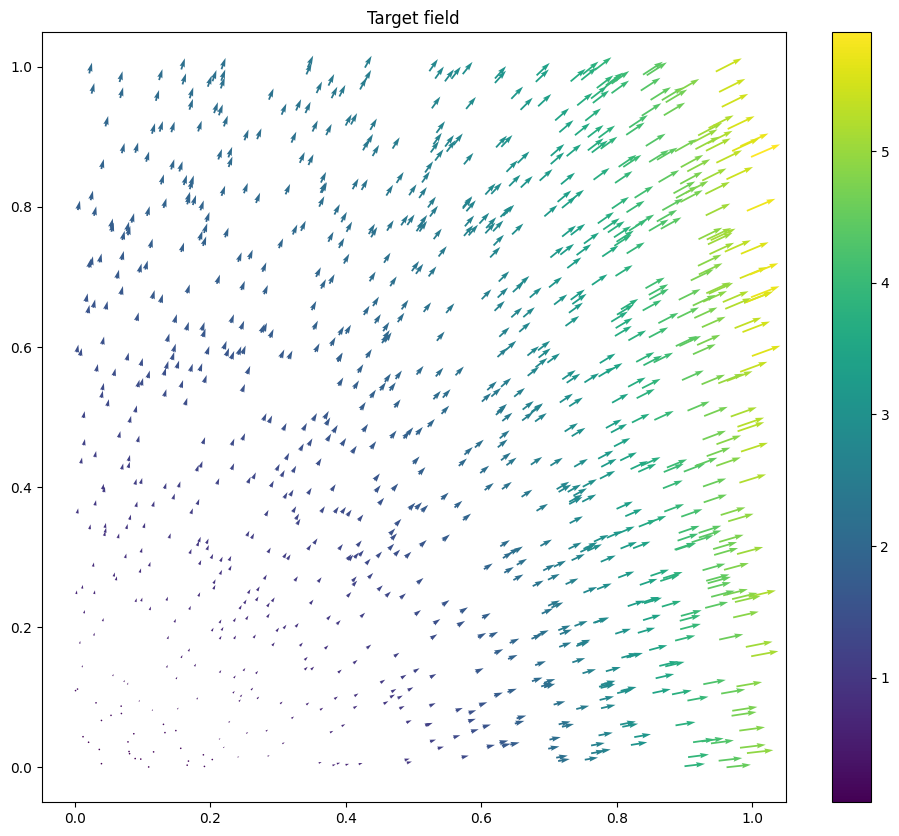

In [10]:
# Plot field (gradient)
space = torch.rand(size=(1000,2))
fig,ax = plt.subplots(1,1,figsize=(12,10))

z = g(space)
p = ax.quiver(space[:,0],space[:,1], z[:,0],z[:,1],z.norm(dim=1))
ax.set_title('Target field')
plt.colorbar(p)
plt.show()

In [11]:
def train_gradient_field(mod,num_epochs=10000,dim=2,batch_size=100,lr=1e-2):
    optimizer = torch.optim.Adam(mod.parameters(),lr=lr)
    for i in range(num_epochs):
        input = torch.rand(size=(batch_size,dim))
        out = mod(input)
        target = g(input)

        loss = (out - target).abs().sum() / batch_size

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        if not i % 1000: print("epoch", i, "loss", loss.item())

In [41]:
model_MMGN = MMGN(input_dim, output_dim, 1, hidden_dim=4)
model_CMGN = CMGN(input_dim, output_dim, 2, hidden_dim=2)
model_ICGN = ICGN(in_dim=input_dim,hidden=5,layers=0, ortho=0)

dim = 2
bsize = 100
epochs = 10000

print("Training C-MGN...")
summary_model(model_CMGN)
train_gradient_field(model_CMGN,num_epochs=epochs,dim=dim,batch_size=bsize)
print("Training M-MGN...")
summary_model(model_MMGN)
train_gradient_field(model_MMGN,num_epochs=epochs,dim=dim,batch_size=bsize)
print("Training ICGN...")
summary_model(model_ICGN)
train_gradient_field(model_ICGN,num_epochs=epochs,dim=dim,batch_size=bsize)

Training C-MGN...
Number of parameters: 14
Layers:
W torch.Size([2, 2])
V torch.Size([2, 2])
bL torch.Size([2])
biases.0 torch.Size([2])
biases.1 torch.Size([2])
epoch 0 loss 2.415609121322632
epoch 1000 loss 0.3945537507534027
epoch 2000 loss 0.041976448148489
epoch 3000 loss 0.034672290086746216
epoch 4000 loss 0.030230917036533356
epoch 5000 loss 0.02383570186793804
epoch 6000 loss 0.023448754101991653
epoch 7000 loss 0.02654607594013214
epoch 8000 loss 0.027318701148033142
epoch 9000 loss 0.028813926503062248
Training M-MGN...
Number of parameters: 22
Layers:
V torch.Size([4, 2])
a torch.Size([2])
W_list.0 torch.Size([2, 4])
biases.0 torch.Size([4])
epoch 0 loss 229.41087341308594
epoch 1000 loss 0.4225398302078247
epoch 2000 loss 0.5008950233459473
epoch 3000 loss 0.4214717447757721
epoch 4000 loss 0.45996803045272827
epoch 5000 loss 0.3624383509159088
epoch 6000 loss 0.44264766573905945
epoch 7000 loss 0.40636998414993286
epoch 8000 loss 0.36229896545410156
epoch 9000 loss 0.4809

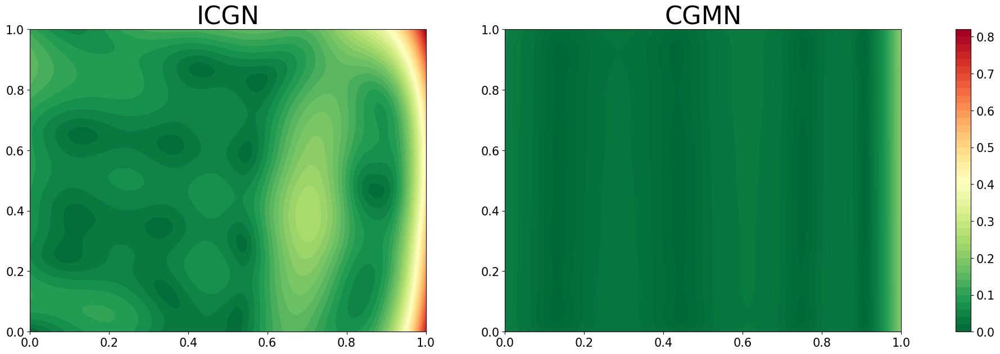

In [44]:
plt.rcParams['figure.figsize'] = (7,7)
fig,ax = plt.subplots(1,2,figsize=(25,7))

xi = torch.linspace(0, 1, 100)
yi = torch.linspace(0, 1, 100)
Xi, Yi = torch.meshgrid(xi, yi)
space = torch.cat([torch.reshape(Xi,(-1,1)),torch.reshape(Yi,(-1,1))],1)
targ = g(space)

out_CMGN = model_CMGN(space).detach().numpy()
zCMGN = (targ - out_CMGN).norm(dim=1).reshape(Xi.shape).T
out_MMGN = model_MMGN(space).detach().numpy()
zMMGN = (targ - out_MMGN).norm(dim=1).reshape(Xi.shape).T
out_ICGN = model_ICGN(space).detach().numpy()
zICGN = (targ - out_ICGN).norm(dim=1).reshape(Xi.shape).T

cmax = max(zCMGN.max(),zICGN.max()) 

#ICGN and CMGN PLOT
icgn_plt = ax[0].contourf(xi, yi, zICGN, levels=50, cmap="RdYlGn_r",vmax=cmax,)
icmgn_plt = ax[1].contourf(xi, yi, zCMGN, levels=50, cmap="RdYlGn_r",vmax=cmax)
ax[0].set_title('ICGN',fontsize=32)
ax[1].set_title('CGMN',fontsize=32)
ax[1].tick_params(axis='both', which='major', labelsize=15)
ax[0].tick_params(axis='both', which='major', labelsize=15)
cbar = plt.colorbar(icgn_plt,ax=ax)
cbar.ax.tick_params(labelsize=15)
plt.show()



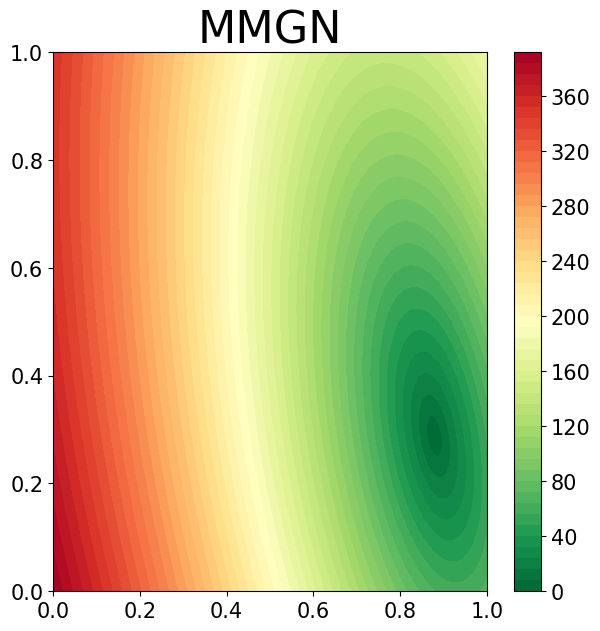

In [45]:
# MMGN plot 
fig,ax =plt.subplots(1,1)
immgn_plt = plt.contourf(xi, yi, zMMGN, levels=50, cmap="RdYlGn_r",vmax=zMMGN.max())
plt.tick_params(axis='both', which='major', labelsize=15)
plt.title('MMGN',fontsize=32)
cbar = plt.colorbar(immgn_plt,ax=ax)
cbar.ax.tick_params(labelsize=15)
plt.show()

## 3. Optimal coupling
We consider the classical Monge problem of transporting a gaussian distribution to another one under the Euclidian cost. Here we choose as in [1] the target distribution to be the standard gaussian one.

We can solve this problem minimizing different losses:
- the Wasserstein cost that has a closed form for 2 gaussians
- the transport cost between source to prediction
- the KL divergence between prediction and target 


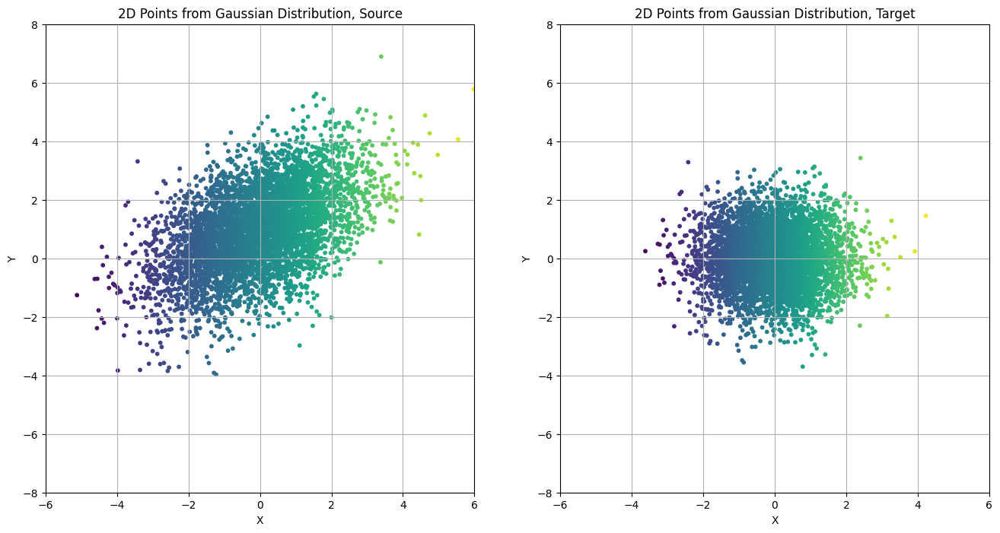

In [32]:
m = torch.tensor([0.0,  1.0])  # Mean of the distribution
C= torch.tensor([[2.0, 0], [1.0, 2.0]])  # Covariance matrix
samples = torch.randn(5000, 2)  # standard normal distribution (target)
inputs = samples @ torch.linalg.cholesky(C).transpose(0, 1) + m # source distribution

def plot_distrib(source,out_or_target,ylim_source=[-8,8], ylim_out=[-8,8], title_source='', title_out=''):
    fig, ax= plt.subplots(1,2,figsize=(16, 8))
    ax[0].scatter(source[:,0].numpy(), source[:,1].numpy(), s=10, c=source[:,0].numpy(), cmap='viridis')
    ax[0].set_xlabel('X')
    ax[0].set_ylabel('Y')
    ax[0].set_title(f'2D Points from Gaussian Distribution, {title_source}')
    ax[0].grid(True)

    ax[0].set_ylim(ylim_source[0],ylim_source[1])
    ax[1].set_ylim(ylim_out[0],ylim_out[1])

    ax[0].set_xlim(-6,6)
    ax[1].set_xlim(-6,6)
    
    ax[1].scatter(out_or_target[:,0].numpy(), out_or_target[:,1].numpy(), s=10, c=source[:,0].numpy(), cmap='viridis')
    ax[1].set_xlabel('X')
    ax[1].set_ylabel('Y')
    ax[1].set_title(f'2D Points from Gaussian Distribution, {title_out}')
    ax[1].grid(True)
    plt.show()

plot_distrib(inputs,samples,title_source="Source", title_out='Target')

In [33]:
def generate_samples(num_samples, mean, cov):
    samples = torch.randn(num_samples, 2)  
    inputs = samples @ torch.linalg.cholesky(cov).transpose(0, 1) + mean 
    return inputs

### a. Explicit OT between Gaussian distributions
Here we combine the transport cost and the Wasserstein cost. 

In [34]:
def visualize_transport(mod,num_samples,mean_source, cov_source, viz=False):
    samples = generate_samples(num_samples,mean_source,cov_source)
    mod.eval()
    out = mod(torch.tensor(samples[:,:].numpy()))
    if viz:
        plot_distrib(samples,out.detach(),title_source="Source", title_out='Generated')
    return samples, out

def W2(m1, C1, m2=None, C2=None):
    dim = len(m1)
    if m2 is None:
        m2 = torch.zeros_like(m1)
    if C2 is None:
        C2 = torch.eye(dim)

    # compute square root matrix 
    U, S, V = torch.svd(torch.matmul(C1, C2))
    S_sqrt = torch.sqrt(S)
    A_sqrt = torch.mm(torch.mm(U, torch.diag(S_sqrt)), V.t())

    # Wasserstein 2
    w2 = torch.sum((m1-m2) ** 2) + torch.trace(C1 + C2 - 2 * A_sqrt)
    return w2  

def train_optimal_coupling(mod,mean_source,cov_source,coef_OT,batch_size=100,dim=2,lr=0.02,num_epochs=10000, num_samp=5000, viz=False):
    optimizer = torch.optim.Adam(mod.parameters(), lr=lr)
    losses = []
    history = []
    loss = 0 
    for i in range(num_epochs):
        mod.train()
        samples = generate_samples(batch_size,mean_source,cov_source)
        optimizer.zero_grad()  
        output = mod(samples) 

        # recover mean and variance matrices 
        output_mean = torch.mean(output, dim=0)
        output_covariance_matrix = torch.matmul((output - output_mean).transpose(0, 1), (output - output_mean)) / batch_size
        if coef_OT !=0:
            loss = W2(output_mean,output_covariance_matrix)
        else:   
            loss = torch.sum(output_mean**2)+ torch.sum((output_covariance_matrix -  torch.eye(2))**2) # Wasserstein cost
            loss +=  coef_OT *torch.sum((output-samples)**2) # weighted Euclidian transport cost 
            loss = loss / batch_size 

        loss.backward() 
        losses.append(loss.item()) 
        optimizer.step() 
        if not i % (num_epochs//10): 
            # visualize loss
            print("epoch", i, "loss", loss.item())
            # visualize learning of the generator 
            history.append(visualize_transport(mod,num_samp, mean_source, cov_source, viz=viz))

    plt.plot(losses)
    plt.title('Loss')
    return history, loss.item()


def plot_history(history, num_epochs):
    steps = len(history)
    fig, ax = plt.subplots(2, steps//2, figsize=(20,10))
    for k in range(steps):
        col = k//2
        row = k%2
        sourc, gen = history[k][0].detach(), history[k][1].detach()
        cost = torch.mean(torch.sqrt(torch.sum((gen - sourc) ** 2, axis=1)))
        ax[row][col].scatter(gen[:,0].numpy(), gen[:,1].numpy(), s=10, c=sourc[:,0].numpy(), cmap='viridis')
        ax[row][col].set_xlabel('X')
        ax[row][col].set_ylabel('Y')
        ax[row][col].grid(True)
        ax[row][col].set_title(f'Epoch {k*(num_epochs//10)}, Transport cost:{np.round(cost.item(),3)}')
        ax[row][col].set_xlim(-8,8)
        ax[row][col].set_ylim(-8,8)
    plt.show()



Training C-MGN...
epoch 0 loss 3.5947887897491455


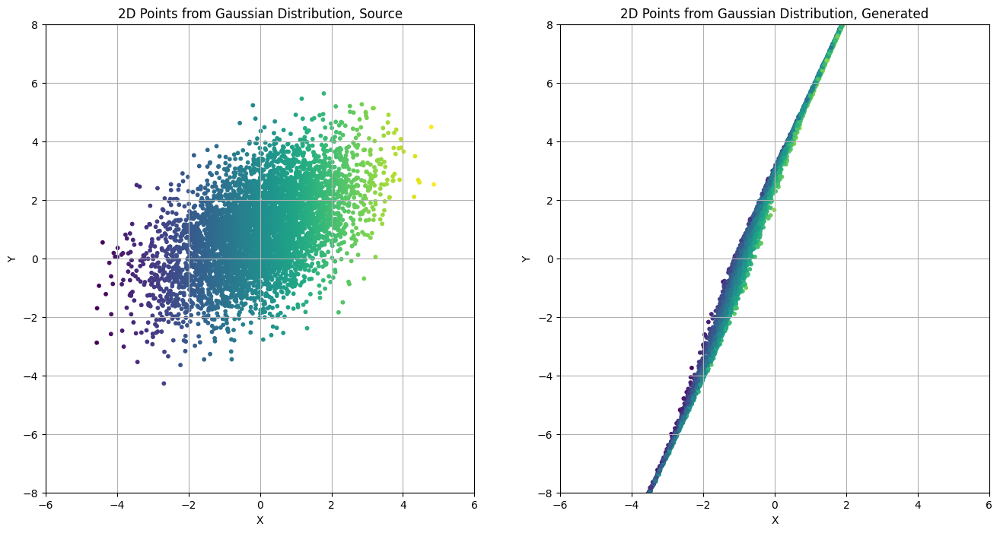

epoch 100 loss 0.042833566665649414


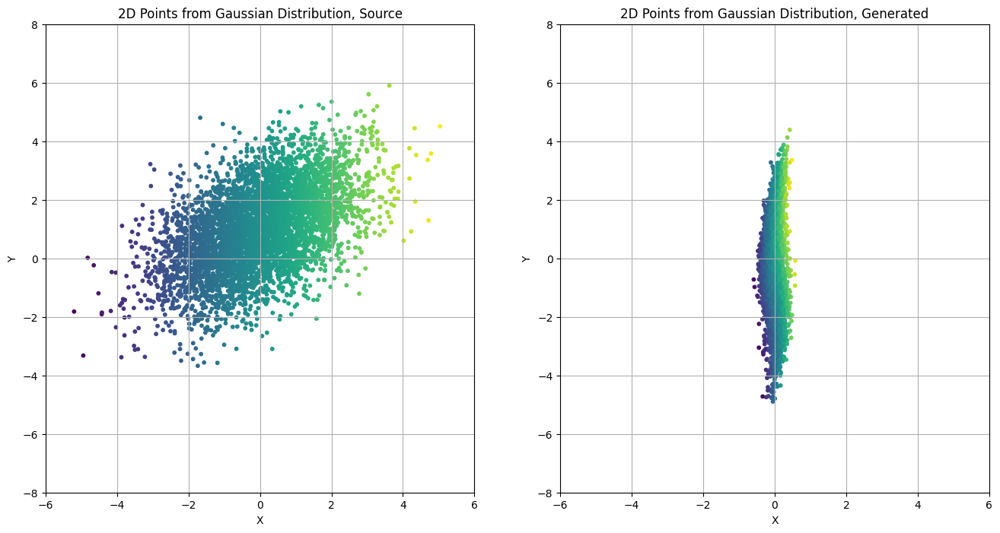

epoch 200 loss 0.010445966385304928


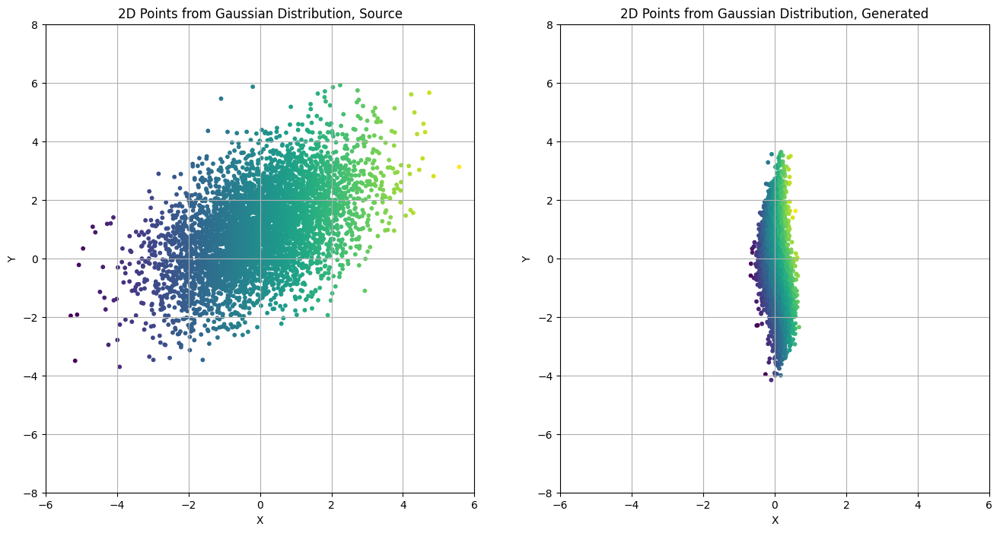

epoch 300 loss 0.010931453667581081


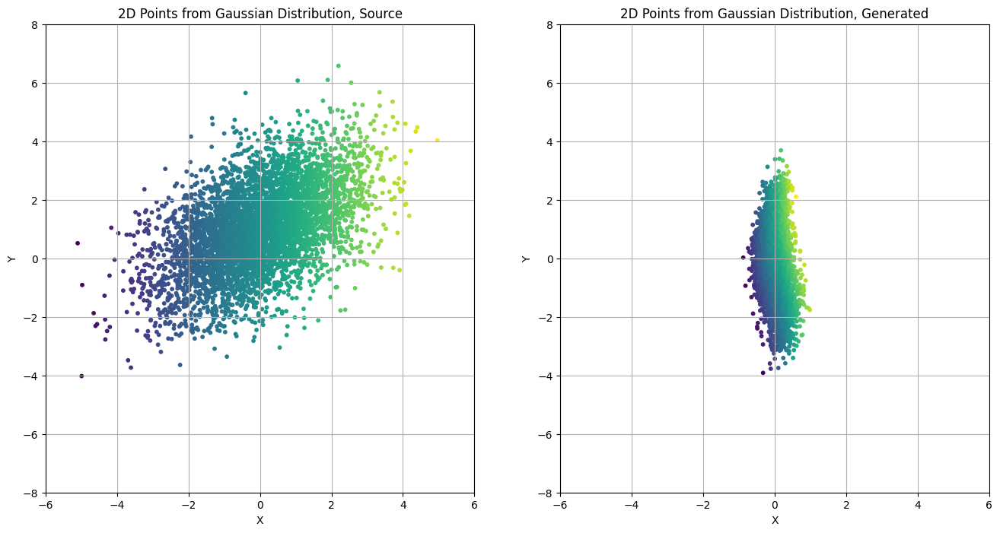

epoch 400 loss 0.007898674346506596


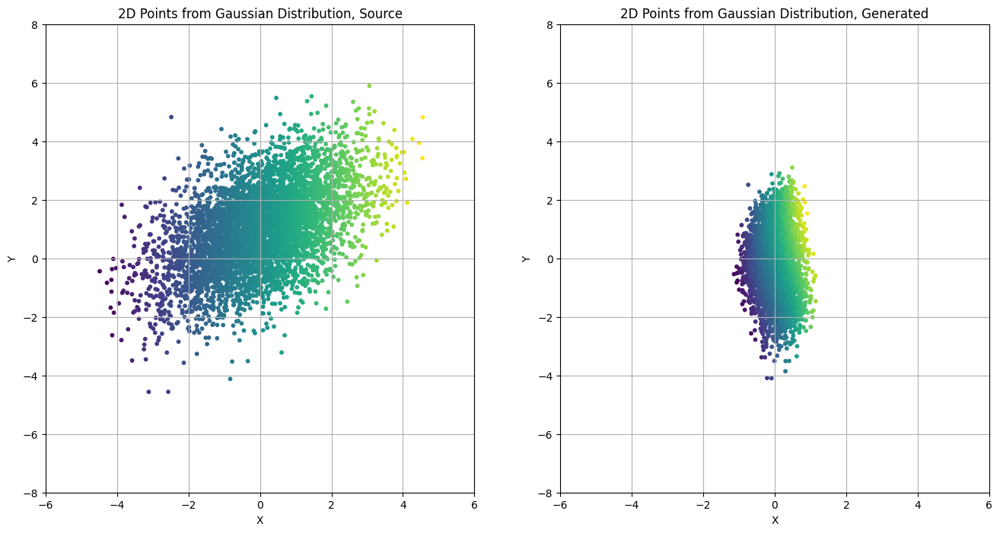

epoch 500 loss 0.003371495520696044


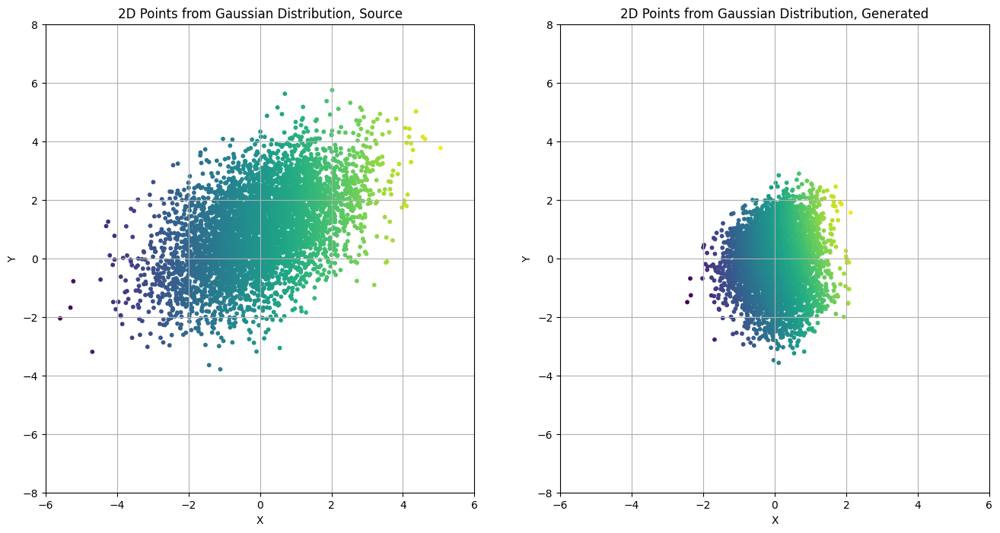

epoch 600 loss 0.0010556706693023443


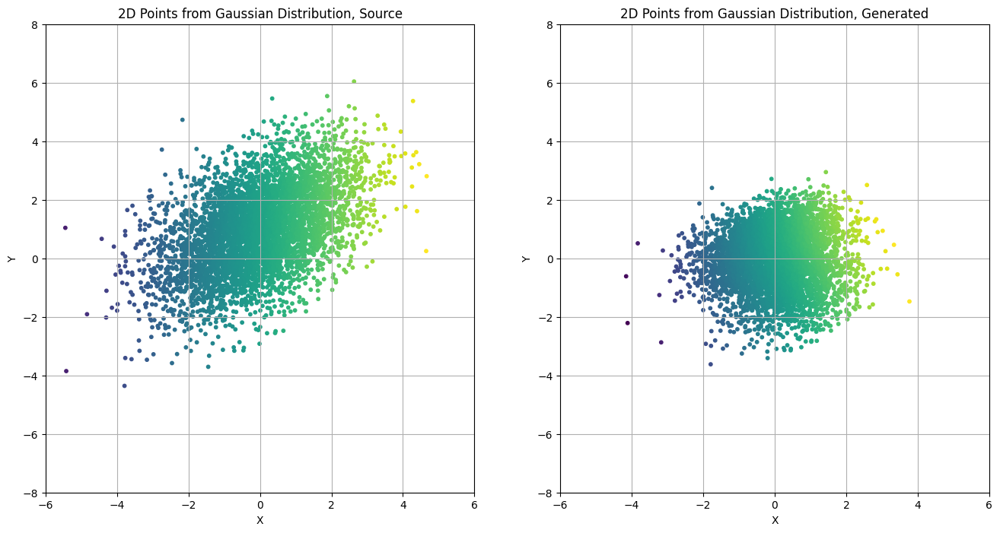

epoch 700 loss 0.001567466533742845


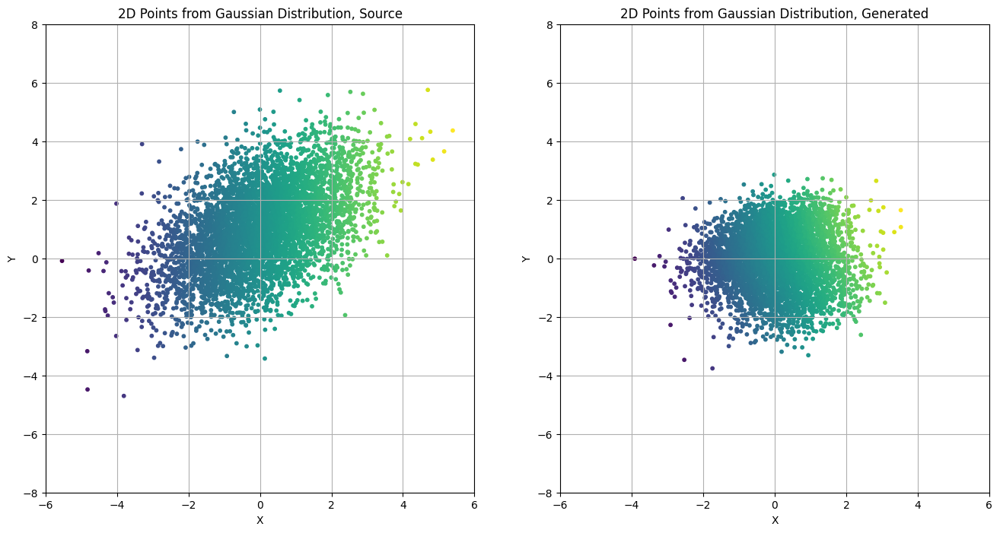

epoch 800 loss 0.0012377065140753984


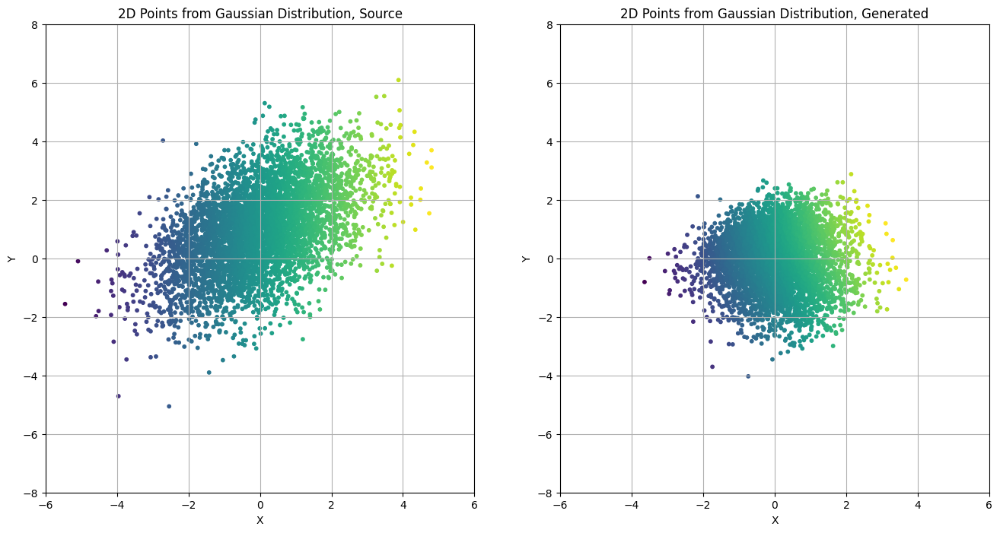

epoch 900 loss 0.00043813197407871485


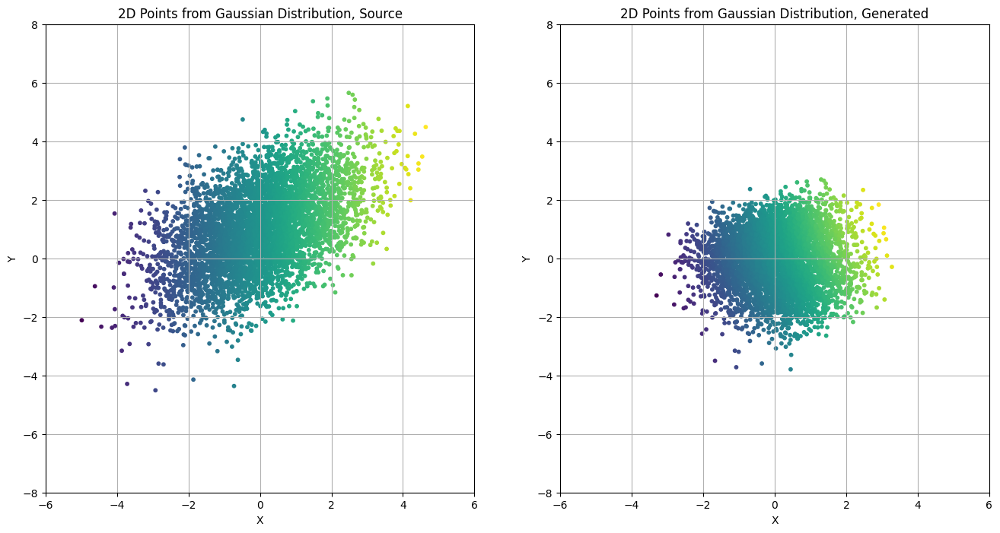

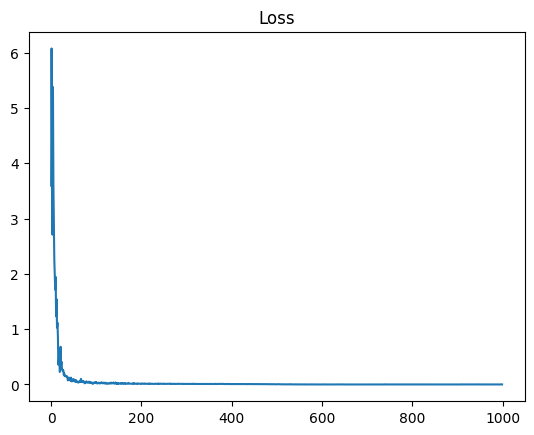

In [35]:
# Training of the CMGN
model_CMGN = None 
model_CMGN = CMGN(input_dim=2, output_dim=2, num_layers=2, hidden_dim=2)
m = torch.tensor([0.0,  1.0])  
C= torch.tensor([[2.0, 0], [1.0, 2.0]])  
dim = 2
bsize = 100
epochs = 1000

print("Training C-MGN...")
history_cmgn,nll_cmgn = train_optimal_coupling(model_CMGN, m, C,coef_OT=0, batch_size=bsize,dim=dim,lr=0.02,num_epochs=epochs, viz=True)


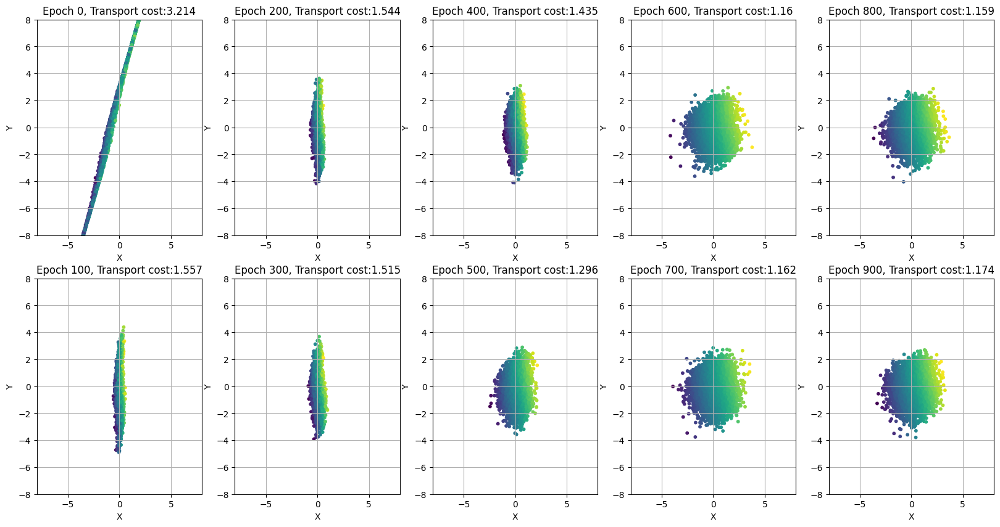

CMGN NLL: 0.001264404971152544


In [36]:
plot_history(history_cmgn,1000)
print('CMGN NLL:', nll_cmgn)

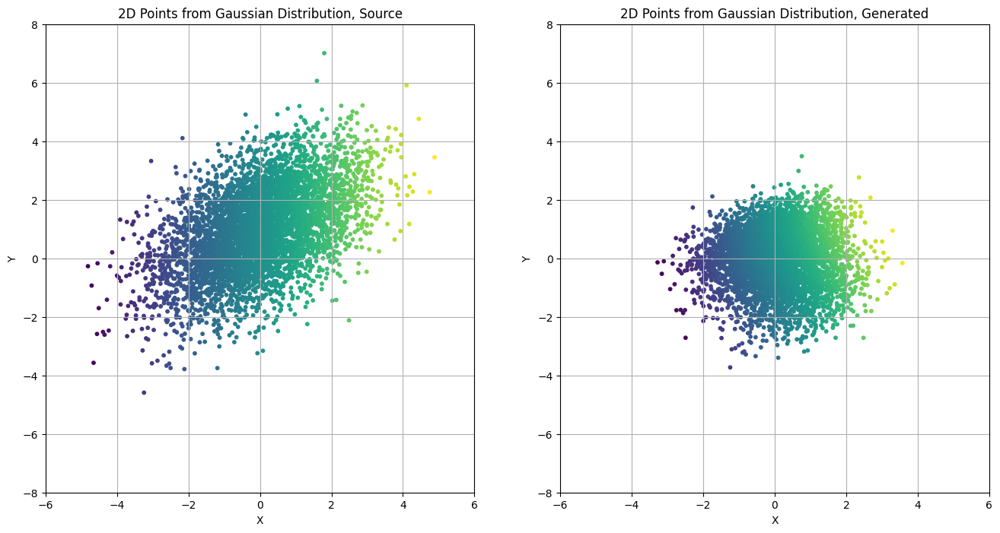

In [37]:
out_CMGN = visualize_transport(model_CMGN,5000,m, C, viz=True)

Training M-MGN...
epoch 0 loss 522757696.0
epoch 1000 loss 6788.4716796875
epoch 2000 loss 991.52001953125
epoch 3000 loss 264.98931884765625
epoch 4000 loss 238.2871551513672
epoch 5000 loss 132.7912139892578
epoch 6000 loss 42.43772888183594
epoch 7000 loss 37.38829803466797
epoch 8000 loss 14.807812690734863
epoch 9000 loss 13.57489013671875


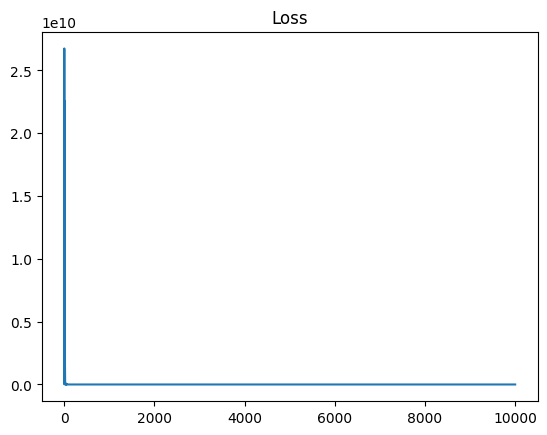

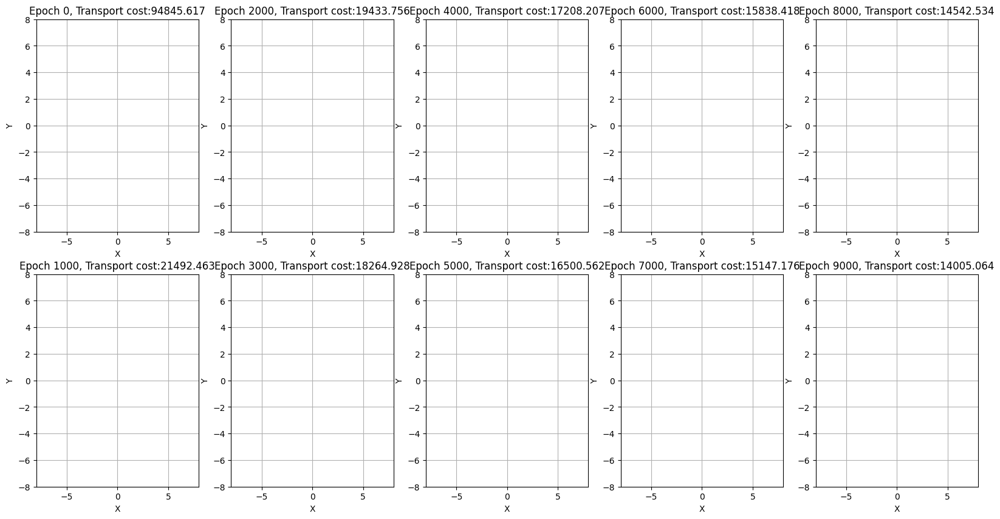

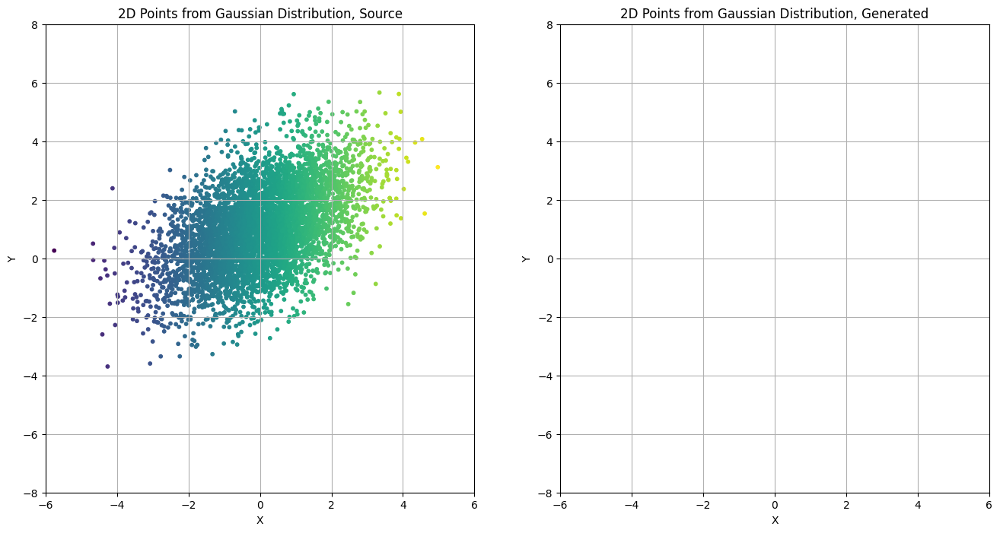

MMGN NLL: 3.6624109745025635
Training ICGN...
epoch 0 loss 0.019898615777492523
epoch 1000 loss 0.010417602024972439
epoch 2000 loss 0.010133224539458752
epoch 3000 loss 0.0005240961909294128
epoch 4000 loss 0.001587491831742227
epoch 5000 loss 0.0002591917582321912
epoch 6000 loss 0.0004592641780618578
epoch 7000 loss 0.0017248645890504122
epoch 8000 loss 0.00036488668411038816
epoch 9000 loss 0.0033011327031999826


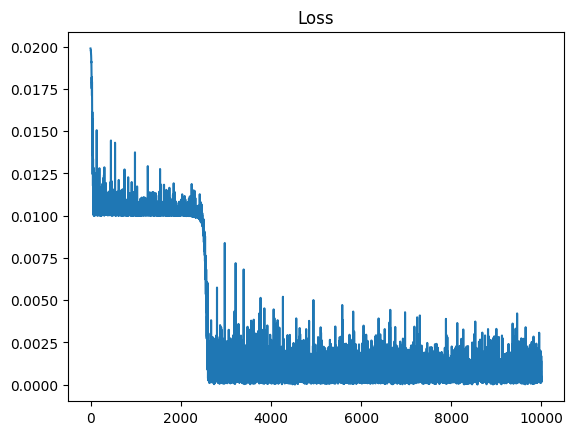

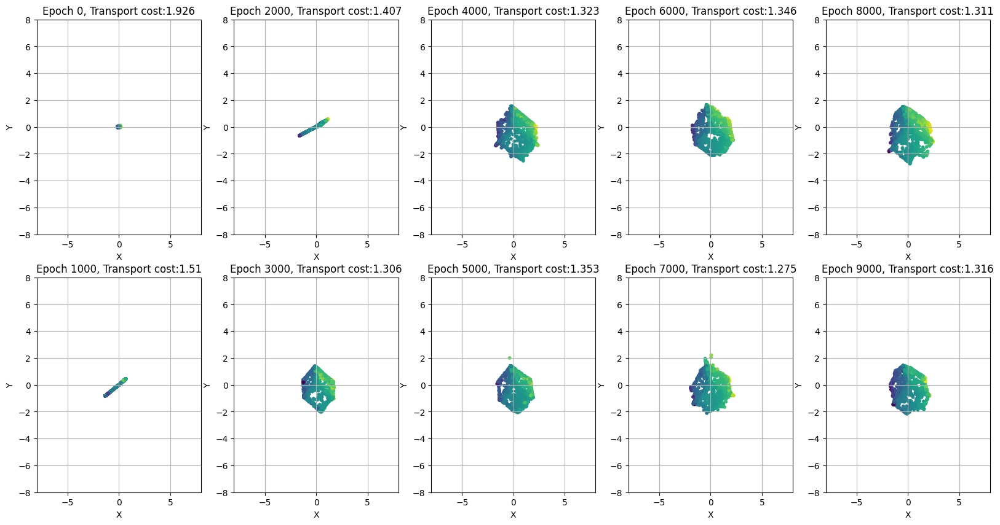

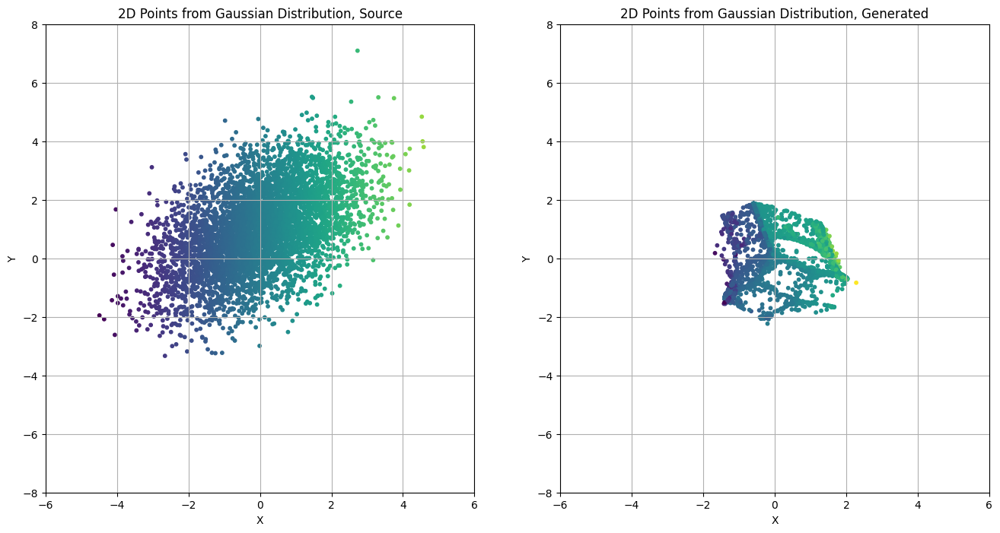

ICGN NLL: 0.0004544293915387243


In [39]:
model_MMGN = MMGN(input_dim=2, output_dim=2, num_modules=1, hidden_dim=4)
model_ICGN = ICGN(in_dim=2,hidden=5,layers=0, ortho=0)

m = torch.tensor([0.0,  1.0])  
C= torch.tensor([[2.0, 0], [1.0, 2.0]])  
epochs = 10000
bsize = 100

print("Training M-MGN...")
history_mmgn,nll_mmgn = train_optimal_coupling(model_MMGN, m, C, coef_OT = 0, batch_size=bsize,dim=dim,lr=1,num_epochs=epochs,viz=False)
plot_history(history_mmgn,epochs)
visualize_transport(model_MMGN,5000,m,C,viz=True)
print('MMGN NLL:', nll_mmgn)

print("Training ICGN...")
history_icgn,nll_icgn = train_optimal_coupling(model_ICGN, m, C, coef_OT=0, batch_size=bsize,dim=dim,lr=0.02,num_epochs=epochs,viz=False)
plot_history(history_icgn,epochs)
visualize_transport(model_ICGN,5000,m,C,viz=True)
print('ICGN NLL:', nll_icgn)

### b. OT with KL between gaussians
This time we use the KL divergence as described in [1]. 

In [239]:
def kl_divergence(mu2, sigma2,mu1=torch.Tensor([0,0]),sigma1=torch.eye(2) ):
    k = mu1.shape[0]  # Dimensionality of the distributions
    sigma2_inv = torch.linalg.inv(sigma2)
    kl = 0.5 * (torch.trace(sigma2_inv @ sigma1) + 
                (mu2 - mu1).T @ sigma2_inv @ (mu2 - mu1) - 
                k + 
                torch.log(torch.linalg.det(sigma2) / torch.linalg.det(sigma1)))
    return kl

In [41]:
def train_OT_kl(mod,mean_source,cov_source, coef_OT=0.1,batch_size=100,dim=2,lr=0.02,num_epochs=10000, num_samp=5000, viz=False):
    optimizer = torch.optim.Adam(mod.parameters(), lr=lr)
    losses = []
    history = []
    for i in range(num_epochs):
        mod.train()
        samples = generate_samples(batch_size,mean_source,cov_source)
        optimizer.zero_grad()  
        output = mod(samples)  
        output_mean = torch.mean(output, dim=0)
        output_covariance_matrix = torch.matmul((output - output_mean).transpose(0, 1), (output - output_mean)) / batch_size

        # kl div + adaptative transport cost (regularization)
        loss = kl_divergence(output_mean,output_covariance_matrix)  + coef_OT * torch.mean(torch.sum((output-samples)**2,dim=1))
        loss.backward() 
        losses.append(loss.item()) 
        optimizer.step() 
        if not i % (num_epochs//10): 
            # visualize loss
            print("epoch", i, "loss", loss.item())
            # visualize learning of the generator 
            history.append(visualize_transport(mod,num_samp, mean_source, cov_source, viz=viz)) # uses mod.eval()

    plt.plot(losses)
    plt.title('Loss')
    plt.show()
    return history, loss.item()


epoch 0 loss 1.8722388744354248


epoch 100 loss 0.15567469596862793
epoch 200 loss 0.14237236976623535
epoch 300 loss 0.16927370429039001
epoch 400 loss 0.15088889002799988
epoch 500 loss 0.13583672046661377
epoch 600 loss 0.17126941680908203
epoch 700 loss 0.1476685106754303
epoch 800 loss 0.1554068624973297
epoch 900 loss 0.1892606019973755


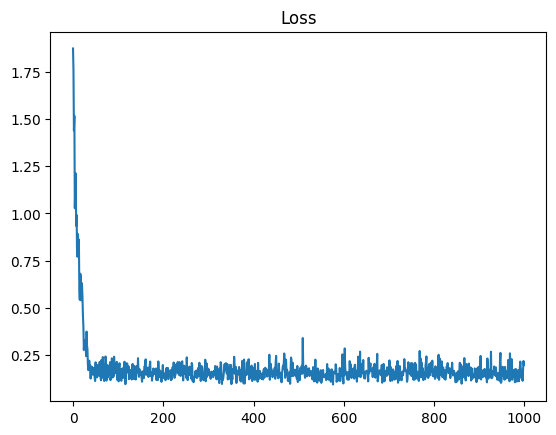

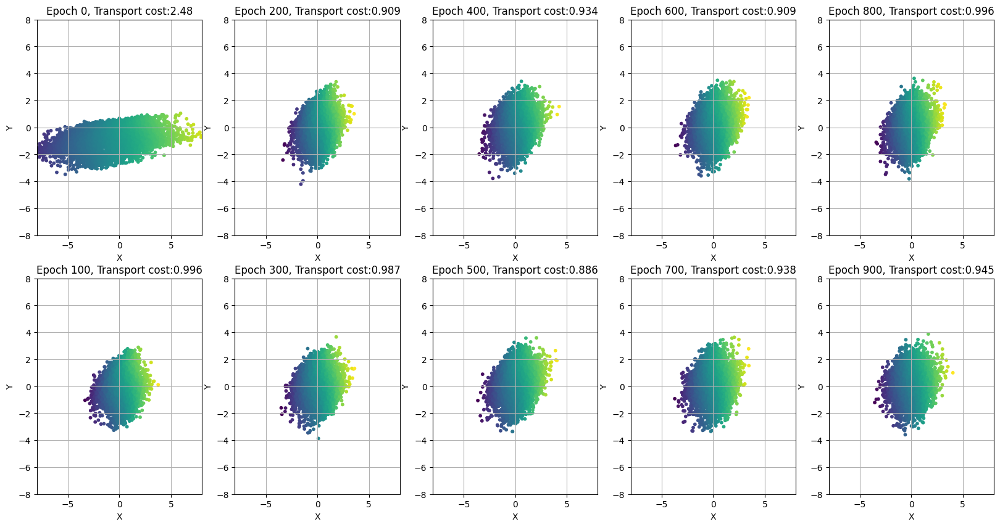

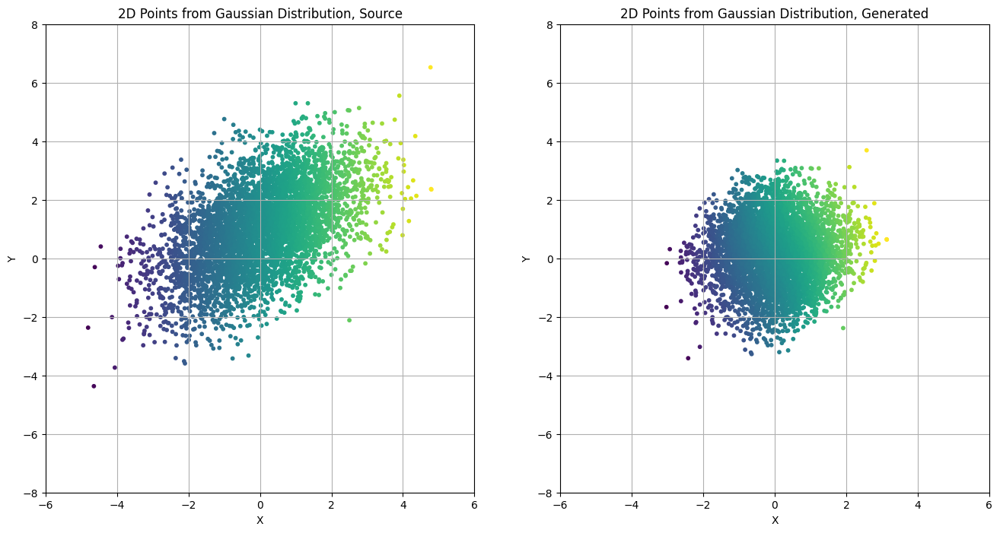

In [43]:
model_CMGN_KL = None 
model_CMGN_KL = CMGN(input_dim=2, output_dim=2, num_layers=2, hidden_dim=2)
m = torch.tensor([0.0,  1.0])  
C= torch.tensor([[2.0, 0], [1.0, 2.0]])    
batch_size = 100
epochs = 1000
n_samp = 5000

history_cmgn_kl, nll_cmgn_kl = train_OT_kl(model_CMGN_KL,m,C, coef_OT=0.1, batch_size=batch_size,dim=2,lr=0.02,num_epochs=epochs, num_samp=n_samp, viz=False)
plot_history(history_cmgn_kl,epochs)
_,_ = visualize_transport(model_CMGN_KL,n_samp,m,C,viz=True)

epoch 0 loss 37.70542907714844
epoch 500 loss 1.1156076192855835
epoch 1000 loss 1.1227037906646729
epoch 1500 loss 0.973216712474823
epoch 2000 loss 1.0464473962783813
epoch 2500 loss 1.0744988918304443
epoch 3000 loss 1.0334303379058838
epoch 3500 loss 1.0881271362304688
epoch 4000 loss 1.0788911581039429
epoch 4500 loss 1.055141568183899


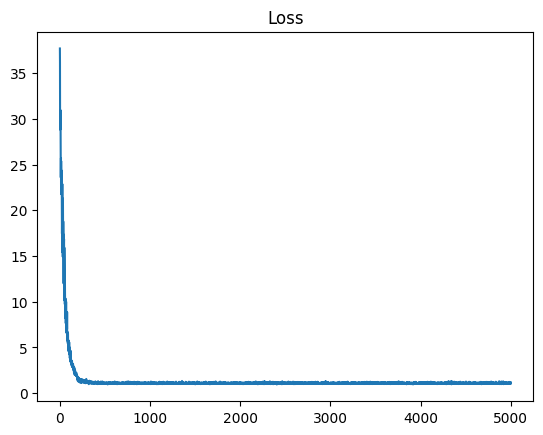

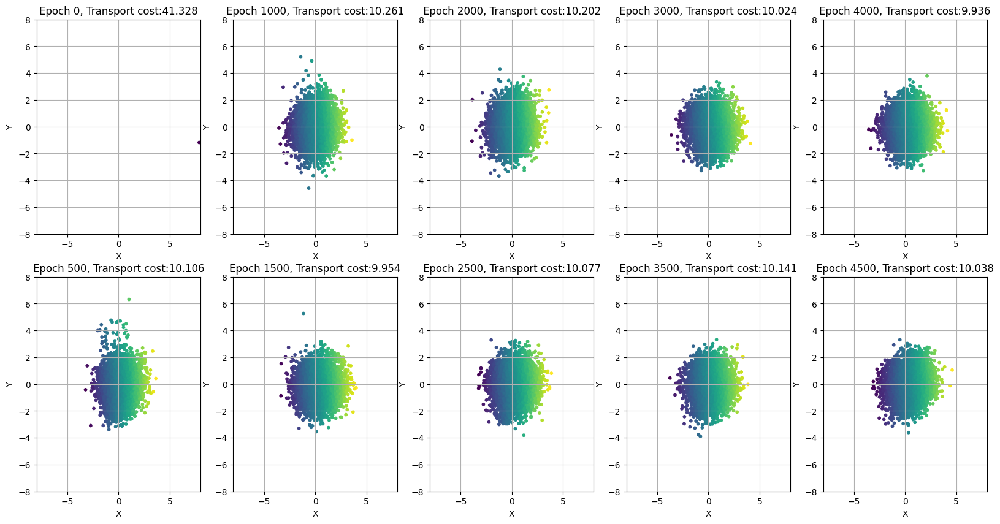

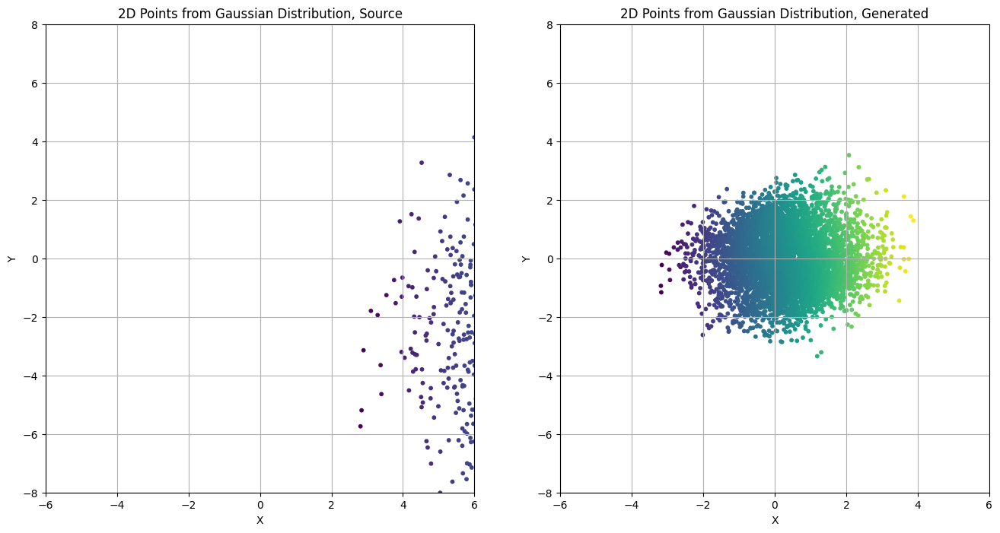

In [46]:
# another example 
model_CMGN_KL = None 
model_CMGN_KL = CMGN(input_dim=2, output_dim=2, num_layers=2, hidden_dim=2)
m = torch.tensor([10,  -2])  
C= torch.tensor([[5.0, 0.4], [1.0, 7.0]])  
batch_size = 100
epochs = 5000
n_samp = 5000

history_cmgn_kl, nll_cmgn_kl = train_OT_kl(model_CMGN_KL,m,C, coef_OT=0.01, batch_size=batch_size,dim=2,lr=0.02,num_epochs=epochs, num_samp=n_samp, viz=False)
plot_history(history_cmgn_kl,epochs)
_,_ = visualize_transport(model_CMGN_KL,n_samp,m,C,viz=True)

epoch 0 loss 11.135041236877441
epoch 1000 loss 0.051171839237213135
epoch 2000 loss 0.04400954395532608
epoch 3000 loss 0.0070241717621684074
epoch 4000 loss 0.014444468542933464
epoch 5000 loss 0.016415804624557495
epoch 6000 loss 0.02563561499118805
epoch 7000 loss 0.005670193582773209
epoch 8000 loss 0.03230499476194382
epoch 9000 loss 0.018339429050683975


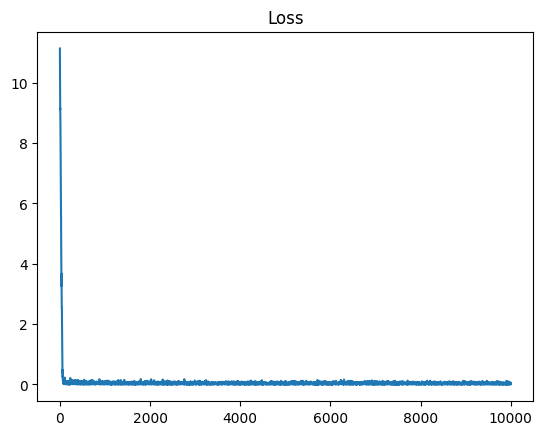

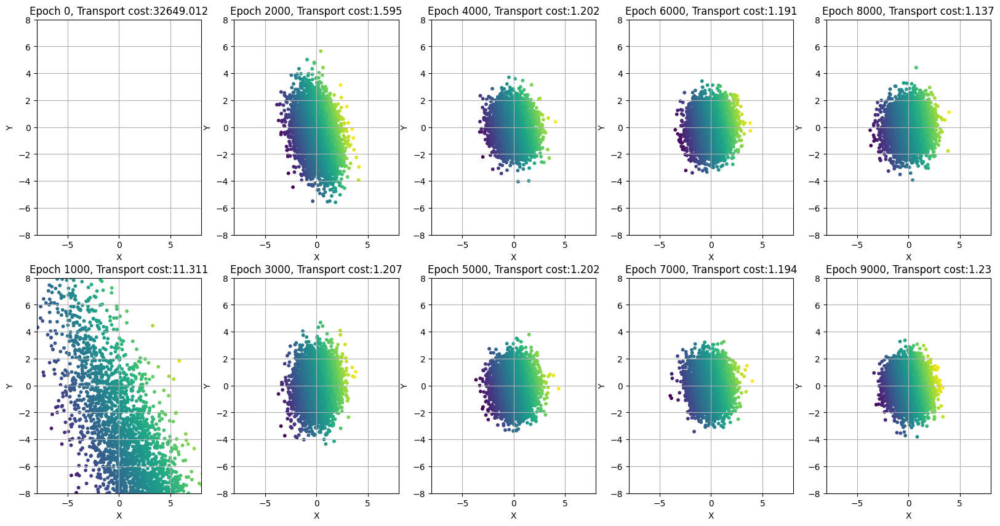

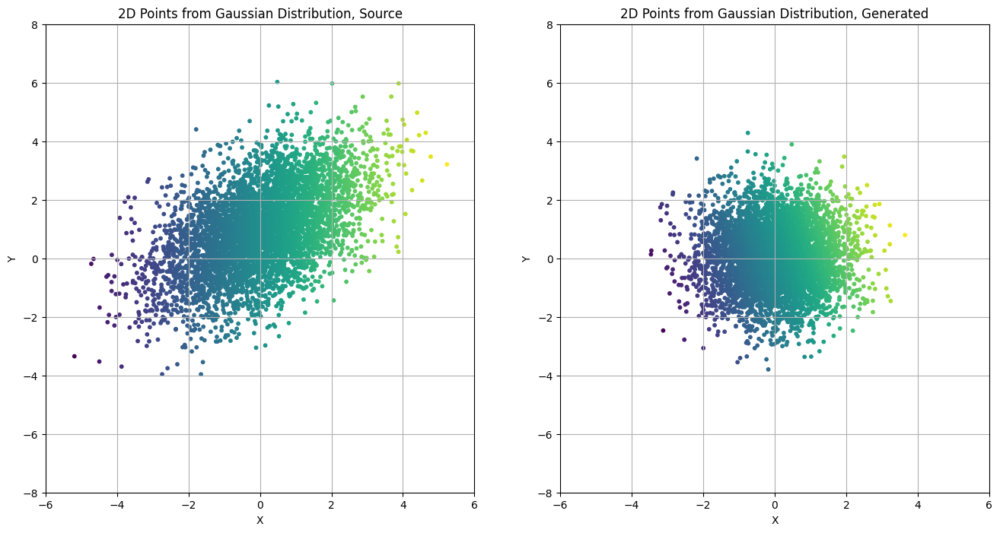

In [47]:
model_MMGN_KL = None
model_MMGN_KL = MMGN(input_dim=2, output_dim=2, num_modules=1, hidden_dim=4)
batch_size = 100
epochs = 10000
n_samp = 5000
m = torch.tensor([0.0,  1.0])  
C= torch.tensor([[2.0, 0], [1.0, 2.0]])  

history_mmgn_kl, nll_mmgn_kl = train_OT_kl(model_MMGN_KL,m,C, coef_OT=0, batch_size=batch_size,dim=2,lr=0.02,num_epochs=epochs, num_samp=n_samp, viz=False)
plot_history(history_mmgn_kl,epochs)
_ ,_ = visualize_transport(model_MMGN_KL,n_samp,m,C,viz=True)

epoch 0 loss 6743.31103515625


epoch 10 loss 1134.643310546875
epoch 20 loss 217.01315307617188
epoch 30 loss 200.84141540527344
epoch 40 loss 108.55460357666016
epoch 50 loss 146.25009155273438
epoch 60 loss 190.9053497314453
epoch 70 loss 290.96917724609375
epoch 80 loss 214.8455810546875
epoch 90 loss 124.44309997558594


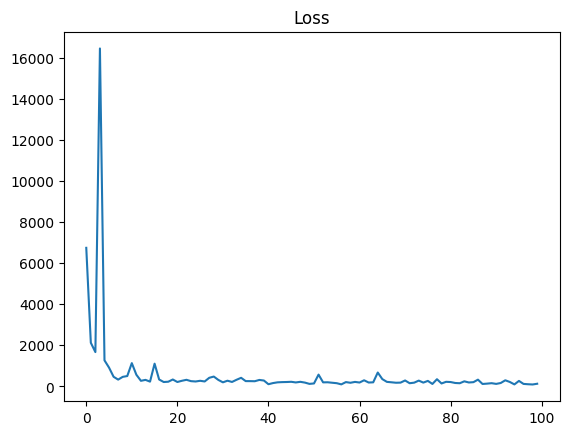

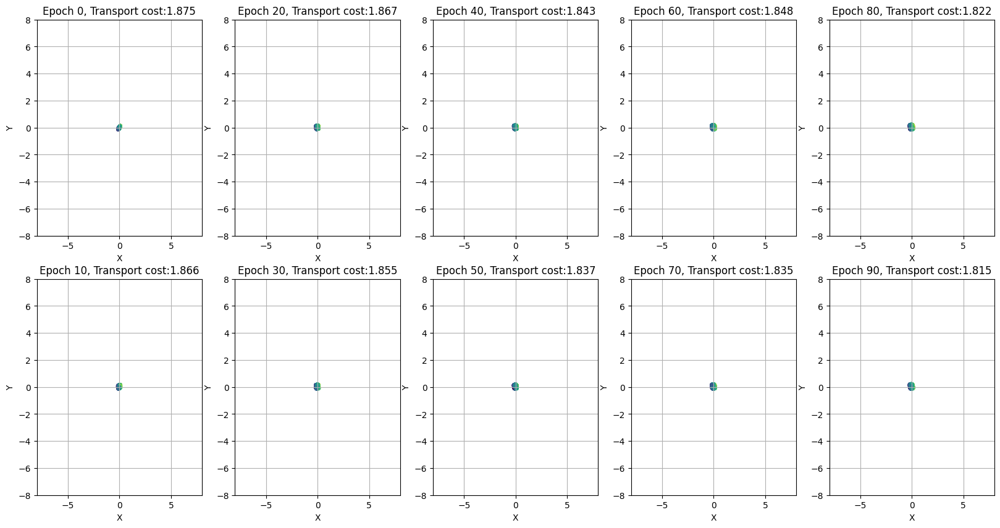

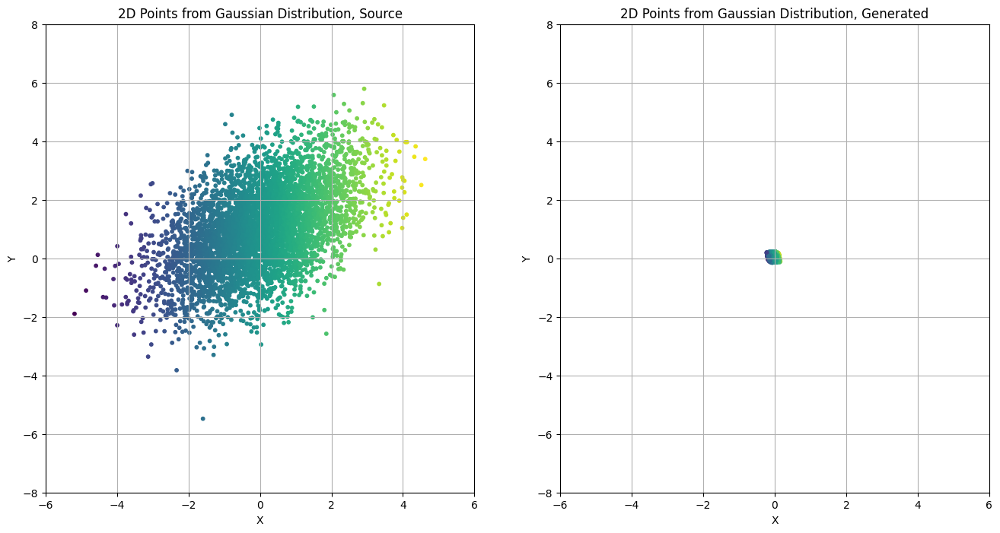

In [48]:
model_ICGN_KL = None
model_ICGN_KL = ICGN(in_dim=2,hidden=5,layers=0, ortho=0)
batch_size = 10
epochs = 100
n_samp = 5000

history_icgn_kl, nll_icgn_kl = train_OT_kl(model_ICGN_KL,m,C, coef_OT=0, batch_size=batch_size,dim=2,lr=0.02,num_epochs=epochs, num_samp=n_samp, viz=False)
plot_history(history_icgn_kl,epochs)
_ ,_ = visualize_transport(model_ICGN_KL,n_samp,m,C,viz=True)

### c. Adapted training routine from https://github.com/CW-Huang/CP-Flow 

In [303]:
! python3 train_ot_coupling.py

init loss: 0.6412229324450762 1.8865056037902832
	 1.5358983848622465 0.00023716788575984537
100 0.06553357373383392 0.3015521764755249
	 ground truth: 1.5358983848622465, estimate: 0.16270473256111145
200 0.006506528960731739 0.18481554090976715
	 ground truth: 1.5358983848622465, estimate: 0.16604489760398863
300 0.011820774184730763 0.3598667085170746
	 ground truth: 1.5358983848622465, estimate: 0.1756872190952301
400 0.019493985282448046 0.29360532760620117
	 ground truth: 1.5358983848622465, estimate: 0.16262551221847535
500 0.013630831347969288 0.10796122997999191
	 ground truth: 1.5358983848622465, estimate: 0.1652950672149658
600 0.021728193866279836 0.1398780196905136
	 ground truth: 1.5358983848622465, estimate: 0.15976744351387023
700 0.0006590987315447272 0.2275339961051941
	 ground truth: 1.5358983848622465, estimate: 0.1630134684085846
/Users/mayajanvier/anaconda3/envs/env_dents/lib/python3.11/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upco

## 4. Color domain adaptation

### 4.1 Sunset

#### a. Simple Maximum Likelihood estimation for target mean and covariance

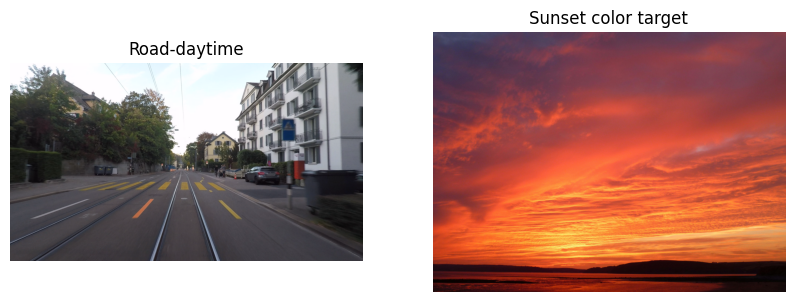

In [268]:
from matplotlib.image import imread
import matplotlib.pyplot as plt
import torch

road_path = 'dark_zurich/GOPR0356_frame_000473_ref_rgb_anon.png'
sunset_path = 'sunset.jpeg'

image1 = imread(road_path)
image2 = imread(sunset_path)
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(image1)
ax[0].set_title('Road-daytime')
ax[1].imshow(image2)
ax[1].set_title('Sunset color target')
for a in ax:
    a.axis('off')
plt.show()

In [270]:
image_source = imread(road_path)
image_target = imread(sunset_path)

# mean and covariance of sunset using MLE
pixels = image_target.reshape(-1,3) / 256 # normalizing to be between [0,1]
pixels_torch = torch.Tensor(pixels) 
mean_target = torch.mean(pixels_torch , dim=0)
data_centered = pixels_torch  - mean_target
covariance_target = torch.matmul(data_centered.T, data_centered) / (pixels_torch.size(0) - 1)

print(mean_target)
print(covariance_target)

# mean and covariance of road using MLE
pixelS = image_source.reshape(-1,3)  # already between [0,1]
pixelS_torch = torch.Tensor(pixelS) 
mean_targetS = torch.mean(pixelS_torch , dim=0)
data_centeredS = pixelS_torch  - mean_targetS
covariance_targetS = torch.matmul(data_centeredS.T, data_centeredS) / (pixelS_torch.size(0) - 1)

print(mean_targetS)
print(covariance_targetS)

tensor([0.6539, 0.2968, 0.2282])
tensor([[0.0647, 0.0303, 0.0032],
        [0.0303, 0.0202, 0.0049],
        [0.0032, 0.0049, 0.0069]])
tensor([0.4069, 0.4048, 0.4122])
tensor([[0.0802, 0.0818, 0.0818],
        [0.0818, 0.0842, 0.0844],
        [0.0818, 0.0844, 0.0858]])


In [271]:
### Transport 
def visualize_color_transport(mod,img,pix,viz=False):
    #mod.eval()
    transported_image = mod(pix).detach().reshape(img.shape)
    print(transported_image.max())
    if viz:
        fig, ax = plt.subplots(1, 3, figsize=(12, 6))
        # Original image
        ax[0].imshow(img)
        ax[0].set_title('Original Image')
        ax[0].axis('off')

        # Transported image
        ax[1].imshow(transported_image)
        ax[1].set_title('Transported Colors')
        ax[1].axis('off')

        # Target colors
        ax[2].imshow(image_target)
        ax[2].set_title('Target colors')
        ax[2].axis('off')
        plt.show()
    return mod(pix).reshape(img.shape)

def train_color(mod, img,pix, target_mean,target_covariance,lr=0.02,num_epochs=100, viz=False):
    optimizer = torch.optim.Adam(mod.parameters(), lr=lr)
    losses = []
    history = [] 
    for i in range(num_epochs):
        mod.train()
        optimizer.zero_grad()  
        output = mod(pix)  
        output_mean = torch.mean(output, dim=0)
        output_covariance_matrix = torch.matmul((output - output_mean).transpose(0, 1), (output - output_mean)) / (output.size(0))

        # kl div 
        loss = kl_divergence(output_mean,output_covariance_matrix, target_mean,target_covariance) 
        loss.backward() 
        losses.append(loss.item()) 
        optimizer.step() 
            
        if not i % (num_epochs//10): 
            # visualize loss
            print("epoch", i, "loss", loss.item())
            # visualize learning of the generator 
            history.append(visualize_color_transport(mod,img,pix,viz=viz))

    plt.plot(losses)
    plt.title('Loss')
    plt.show()
    return history, loss.item()

def plot_color_history(history,num_epochs):
    steps = len(history)
    fig, ax = plt.subplots(2, steps//2, figsize=(20,10))
    for k in range(steps):
        col = k//2
        row = k%2
        gen = history[k].detach()
        ax[row][col].imshow(gen)
        ax[row][col].set_title(f'Epoch {k*(num_epochs//10)}')
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch 0 loss 1838.8021240234375
tensor(4.3345)


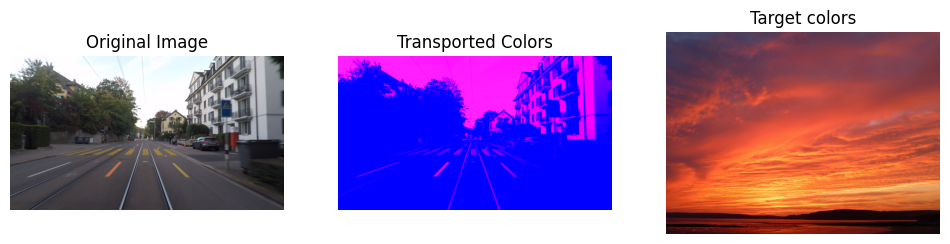

epoch 100 loss 1.8922877311706543
tensor(3.5537)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


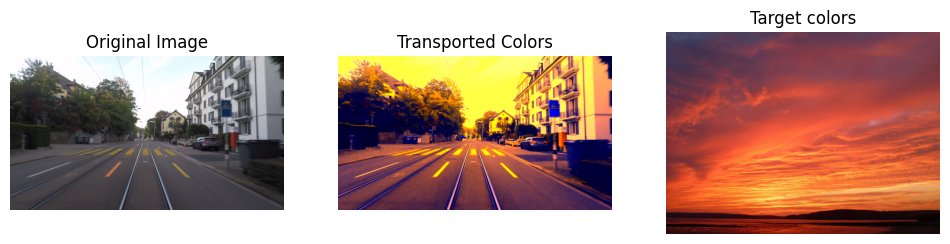

epoch 200 loss 1.4661368131637573
tensor(3.3305)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


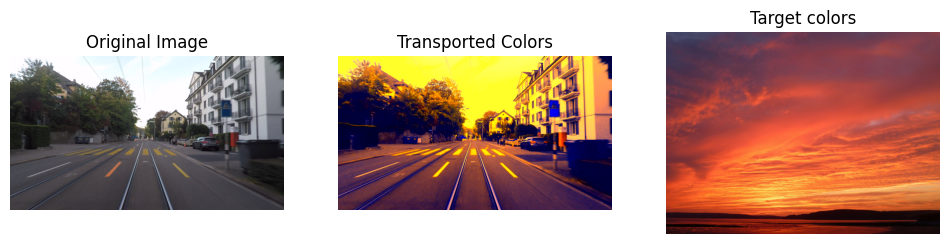

epoch 300 loss 1.2308984994888306
tensor(3.1175)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


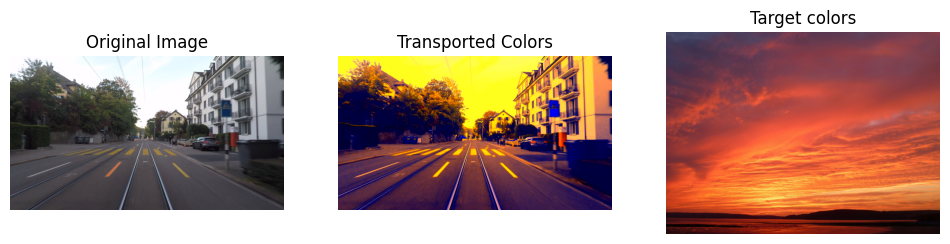

epoch 400 loss 1.0689905881881714
tensor(2.9391)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


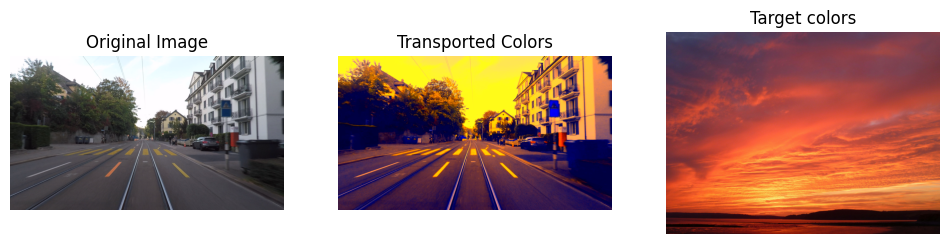

epoch 500 loss 0.9396514892578125
tensor(2.7837)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


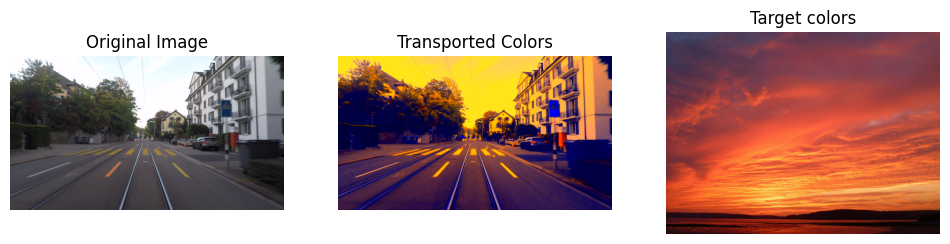

epoch 600 loss 0.8250583410263062
tensor(2.6466)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


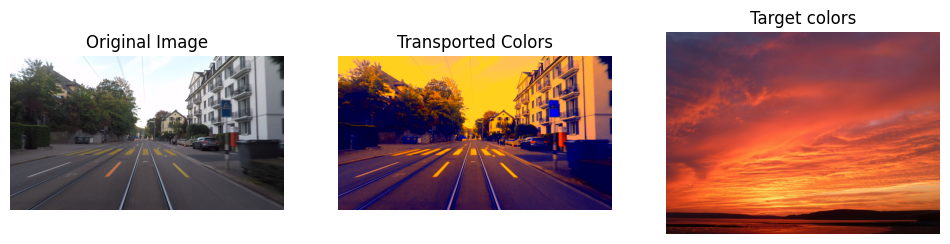

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch 700 loss 0.7151814103126526
tensor(2.5257)


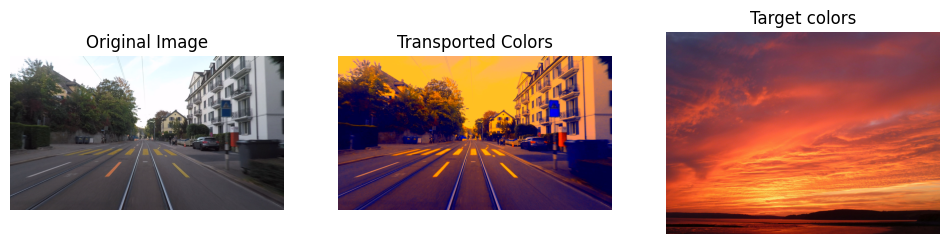

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch 800 loss 0.6051012873649597
tensor(2.4162)


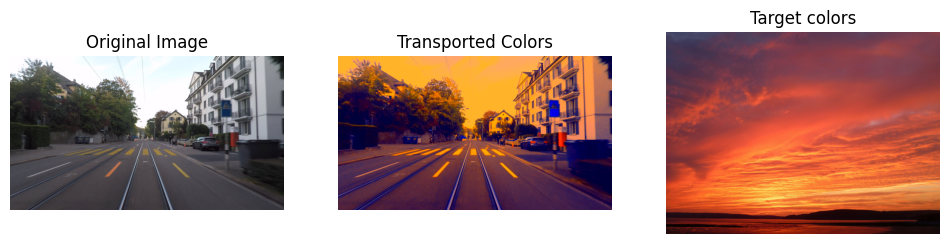

epoch 900 loss 0.4952160120010376
tensor(2.3134)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


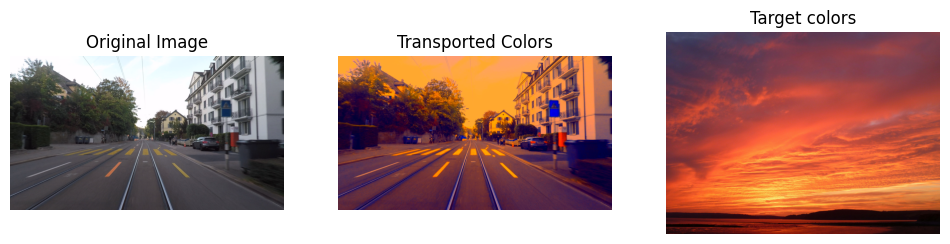

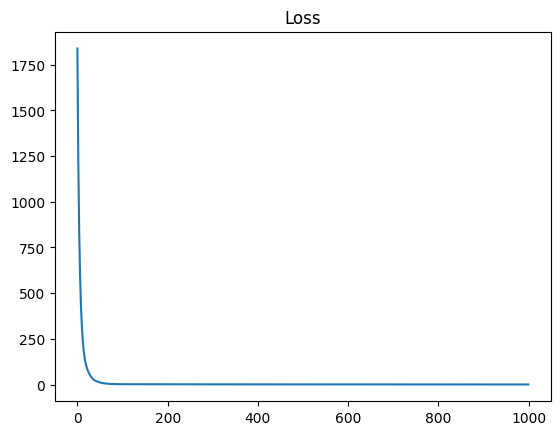

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

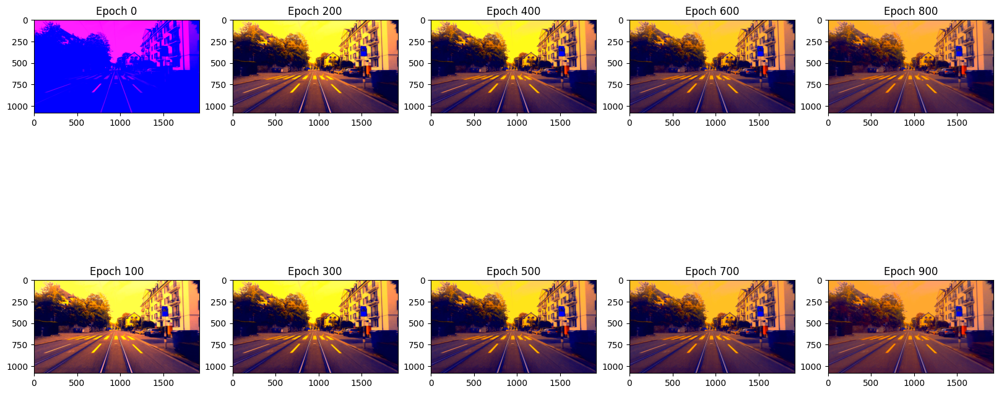

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(2.2177)


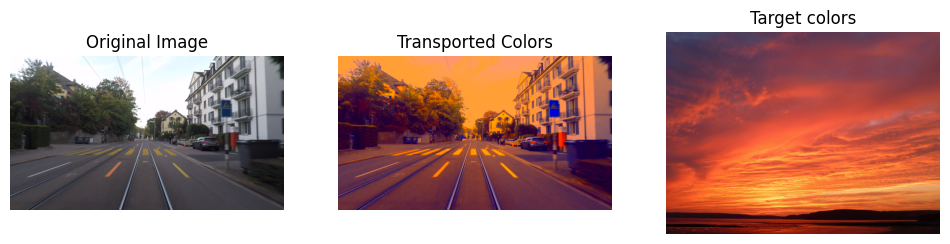

In [273]:
# sans eval mode
model_CMGN_color2 = None 
model_CMGN_color2 = CMGN(input_dim=3, output_dim=3, num_layers=2, hidden_dim=3)
epochs = 1000

history_cmgn_col, nll_cmgn_col = train_color(model_CMGN_color2, image_source, pixelS_torch, mean_target, covariance_target,lr=0.02,num_epochs=epochs, viz=True)
plot_color_history(history_cmgn_col,epochs)
_= visualize_color_transport(model_CMGN_color2,image_source,pixelS_torch, viz=True)

tensor(3.2921)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


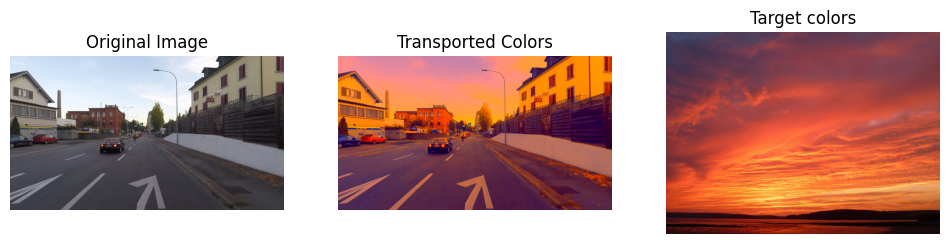

In [274]:
# apply on another image 
image_source2 = imread('dark_zurich/GOPR0356_frame_000375_ref_rgb_anon.png')
pixelS_torch2 = torch.Tensor(image_source2.reshape(-1,3)) 
_ = visualize_color_transport(model_CMGN_color2,image_source2, pixelS_torch2, viz=True)

Number of parameters: 27
Layers:
W torch.Size([3, 3])
V torch.Size([3, 3])
bL torch.Size([3])
biases.0 torch.Size([3])
biases.1 torch.Size([3])


epoch 0 loss 69446.3359375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(1.6396)


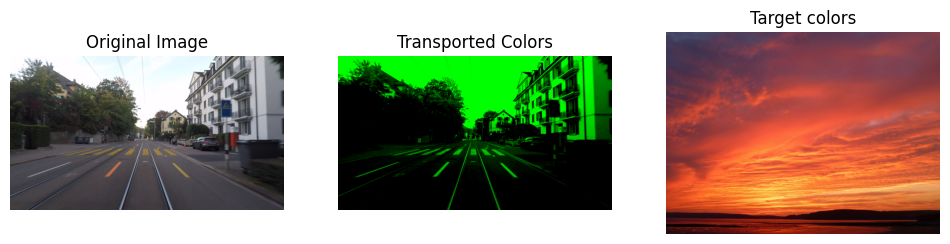

epoch 100 loss 19.96097755432129
tensor(0.9638)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


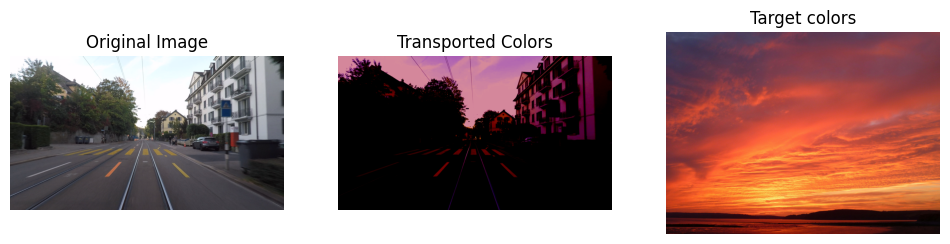

epoch 200 loss 17.535457611083984
tensor(1.0109)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


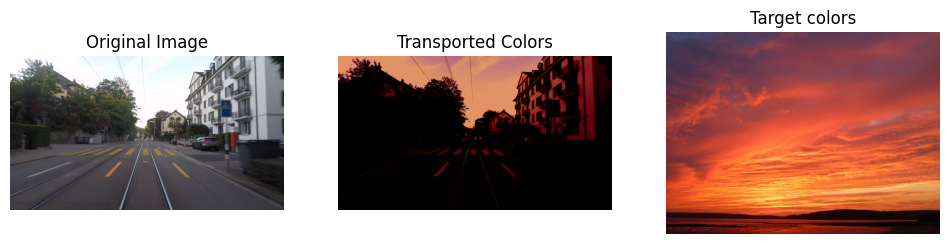

epoch 300 loss 16.240158081054688
tensor(1.0312)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


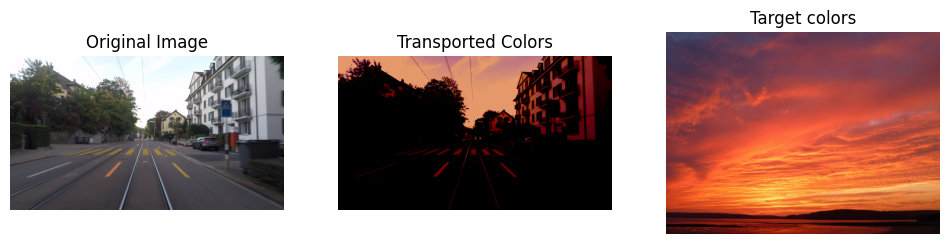

epoch 400 loss 14.947968482971191
tensor(1.0559)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


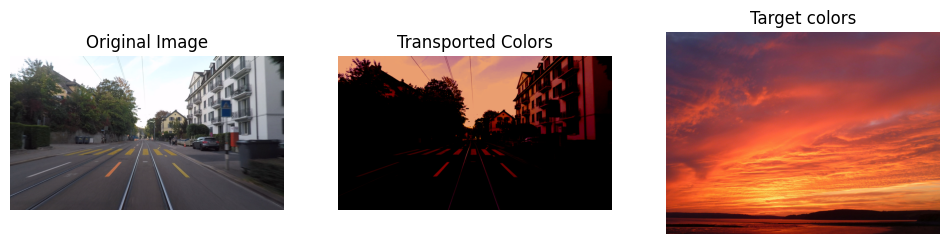

epoch 500 loss 13.73468017578125
tensor(1.0839)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


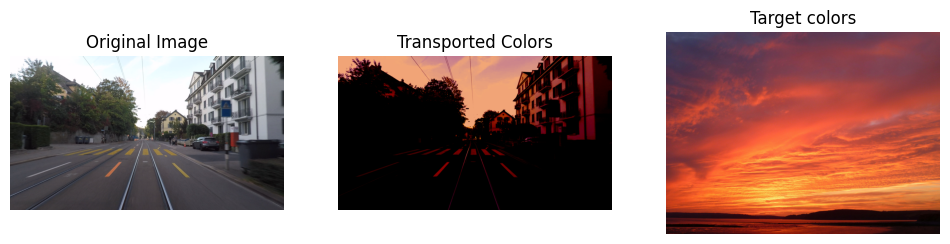

epoch 600 loss 12.544639587402344
tensor(1.1149)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


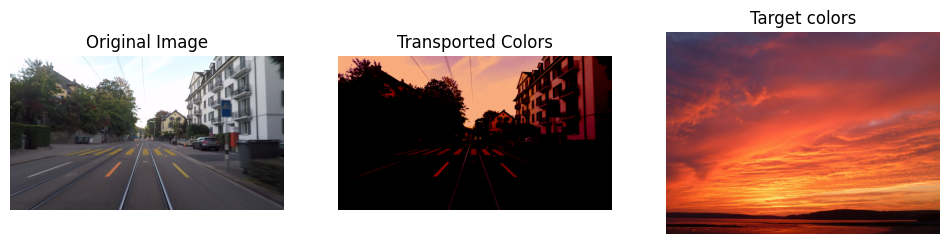

epoch 700 loss 11.49515151977539
tensor(1.1482)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


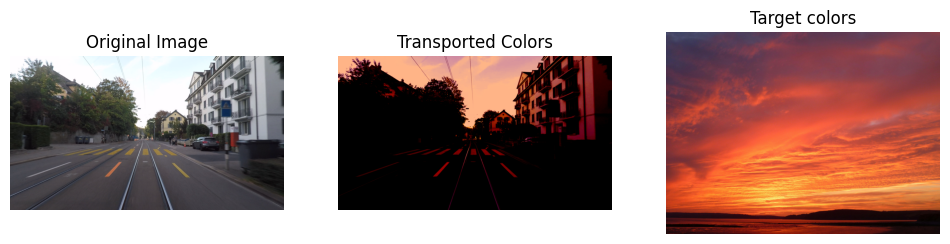

epoch 800 loss 10.506926536560059
tensor(1.1835)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


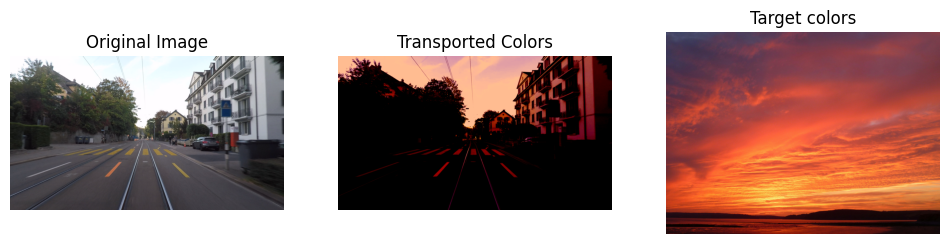

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch 900 loss 9.6288480758667
tensor(1.2204)


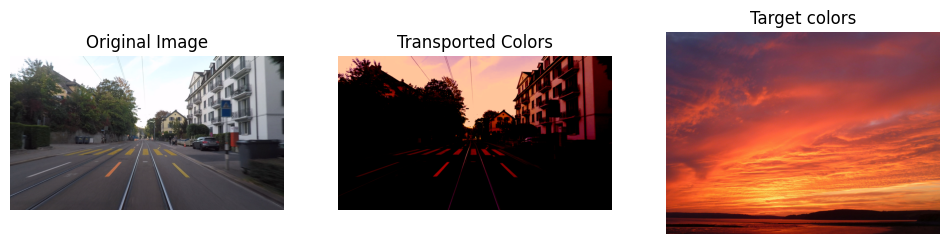

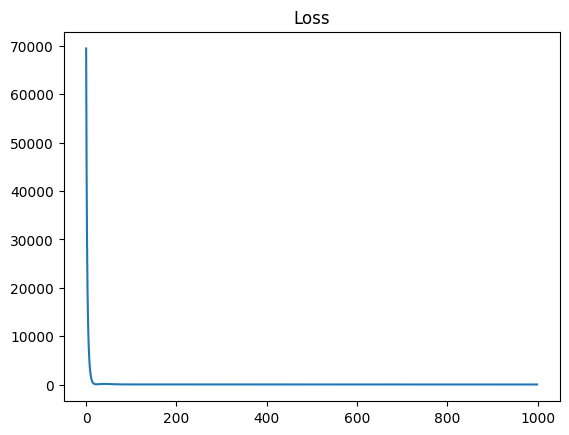

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

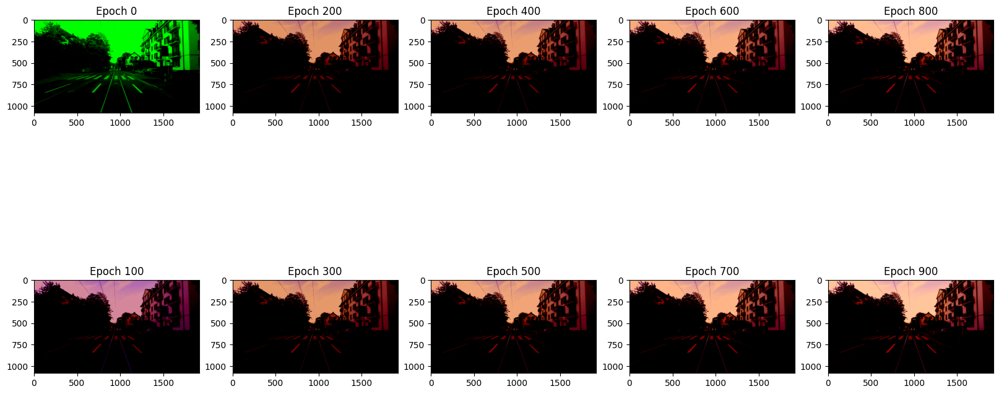

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(1.2580)


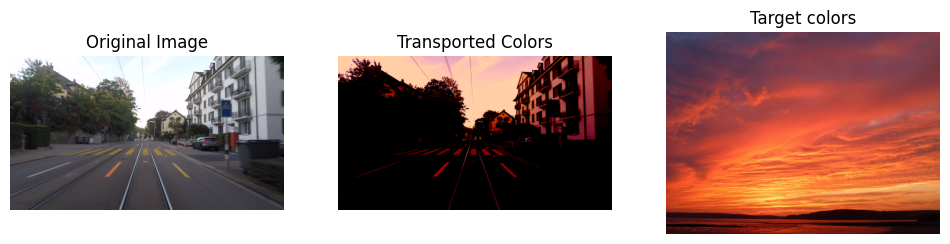

In [250]:
# other training 
model_CMGN_color = None 
model_CMGN_color = CMGN(input_dim=3, output_dim=3, num_layers=2, hidden_dim=3)
summary_model(model_CMGN_color)
epochs = 1000

history_cmgn_col, nll_cmgn_col = train_color(model_CMGN_color, image_source, pixelS_torch, mean_target, covariance_target,lr=0.02,num_epochs=epochs, viz=True)
plot_color_history(history_cmgn_col,epochs)
_= visualize_color_transport(model_CMGN_color,image_source,pixelS_torch, viz=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(1.7727)


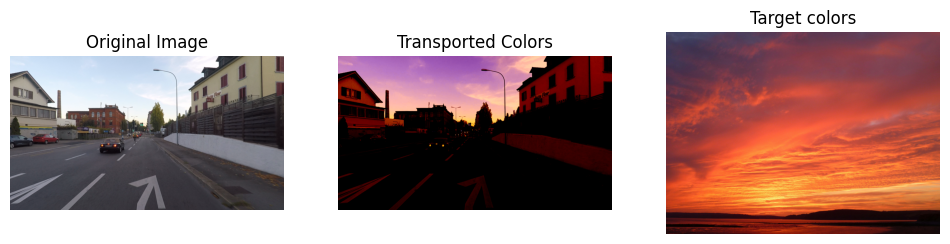

In [252]:
# apply on another image 
image_source = imread('dark_zurich/GOPR0356_frame_000375_ref_rgb_anon.png')
pixelS_torch = torch.Tensor(image_source.reshape(-1,3)) 
_ = visualize_color_transport(model_CMGN_color,image_source, pixelS_torch, viz=True)

In [ ]:
image_source = imread(road_path)
image_target = imread(sunset_path)
pixelS = image_source.reshape(-1,3)  
pixelS_torch = torch.Tensor(pixelS)

model_MMGN_color = None 
model_MMGN_color = MMGN(input_dim=3, output_dim=3, num_modules=1, hidden_dim=3)
summary_model(model_MMGN_color)
epochs = 1000

history_mmgn_col, nll_mmgn_col = train_color(model_MMGN_color, image_source, pixelS_torch, mean_target, covariance_target,lr=0.002,num_epochs=epochs, viz=True)
plot_color_history(history_mmgn_col,epochs)
_= visualize_color_transport(model_MMGN_color,image_source, viz=True)

#### b. Multivariate Gaussian fit for target mean and covariance

In [284]:
# Fit multivariate gaussian on sunset colors
from sklearn.mixture import GaussianMixture
import os
import joblib

gmm_path = 'gmm/fitted_gmm_10.joblib'
if not os.path.exists(gmm_path):
    pixels = image_target.reshape(-1, 3)

    idx = np.random.randint(pixels.shape[0], size=20000)
    pixels_sampled = pixels[idx]

    num_components = 500 # Number of Gaussian components
    gmm = GaussianMixture(n_components=num_components, random_state=42, max_iter = 100)
    gmm.fit(pixels_sampled)
else:
    gmm = joblib.load(gmm_path)

In [285]:
mean_sunset = torch.Tensor(gmm.means_) #, dtype=torch.float64)
covariances_sunset = torch.Tensor(gmm.covariances_) #, dtype=torch.float64)
print(mean_sunset.shape)
print(covariances_sunset.shape)

torch.Size([10, 3])
torch.Size([10, 3, 3])


samples shape :  (11469152, 3)


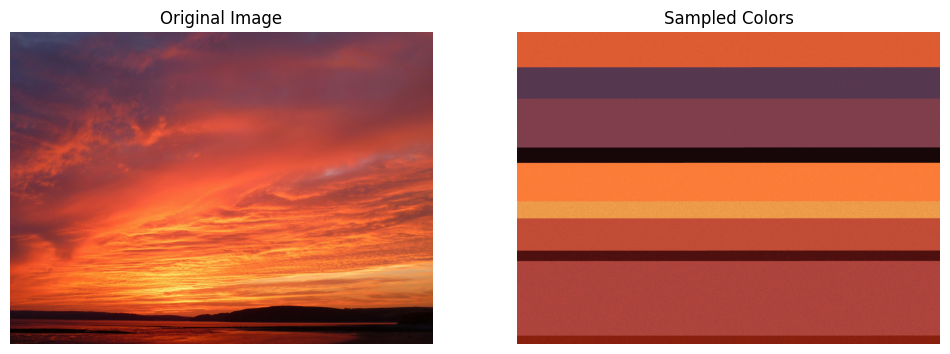

In [286]:
def visualise_sunset():
  samples, labels = gmm.sample(image_target.shape[0]*image_target.shape[1])
  print("samples shape : ", samples.shape)
  samples = np.clip(samples, 0, 255).astype(np.uint8)  # Clip to valid pixel values

  fig, ax = plt.subplots(1, 2, figsize=(12, 6))

  # Original image
  ax[0].imshow(image_target)
  ax[0].set_title('Original Image')
  ax[0].axis('off')

  sampled_image = samples.reshape(image_target.shape)
  # Sampled colors
  ax[1].imshow(sampled_image)
  ax[1].set_title('Sampled Colors')
  ax[1].axis('off')

  plt.show()

visualise_sunset()

In [287]:
def kl_divergence_gmm(mu2, sigma2,mean_sunset,covariance_sunset, k = 3):
    kl_array = torch.zeros(mean_sunset.shape[0])
    sigma2_inv = torch.linalg.inv(sigma2)
    for i in range(mean_sunset.shape[0]):
      mu1 = mean_sunset[i]
      sigma1 = covariance_sunset[i]

      kl = 0.5 * (torch.trace(sigma2_inv @ sigma1) +
                  (mu2 - mu1).T @ sigma2_inv @ (mu2 - mu1) -
                  k +
                  torch.log(torch.linalg.det(sigma2) / torch.linalg.det(sigma1)))
      kl_array[i] = kl

    return torch.min(kl_array)

In [290]:
def train_color_GMM(mod, img, pix, target_mean,target_covariance,lr=0.02,num_epochs=50000, batch_size=100, viz=False):  
  optimizer = torch.optim.Adam(mod.parameters(), lr=lr)
  losses = []
  history = [] 
  for i in range(num_epochs):
      mod.train()
      idx = np.random.randint(pix.shape[0], size=batch_size)
      pixels_sampled = torch.Tensor(pix[idx]) 

      optimizer.zero_grad()
      output = mod(pixels_sampled)
      output_mean = torch.mean(output, dim=0)
      output_covariance_matrix = torch.matmul((output - output_mean).transpose(0, 1), (output - output_mean)) / batch_size

      loss = kl_divergence_gmm(output_mean,output_covariance_matrix,target_mean, target_covariance)
      loss.backward()
      losses.append(loss.item())
      optimizer.step()
      if not i % (num_epochs//10): 
          # visualize loss
          print("epoch", i, "loss", loss.item())
          # visualize learning of the generator 
          history.append(visualize_color_transport(mod,img,torch.Tensor(pix),viz=viz))
          #output = mod(torch.Tensor(pix))
          ##output = output.reshape(img.shape)
          #plt.imshow(output.detach())
          #plt.axis('off')
          #plt.title(f'Epoch {i}')
          #plt.show()


  plt.plot(losses)
  plt.title('Loss')
  plt.show()
  return history, loss.item()

In [ ]:
### Transport
random.seed(1234)
pixelS = image_source.reshape(-1,3)
epochs = 10000
batch_size = 100

model_CMGN_color_GMM=None
model_CMGN_color_GMM = CMGN(input_dim=3, output_dim=3, num_layers=2, hidden_dim=3)

history_gmm, nll_gmm =train_color_GMM(model_CMGN_color_GMM, image_source, pixelS, mean_sunset, covariances_sunset,lr=0.02,num_epochs=epochs,batch_size=batch_size,viz=True)
#plot_color_history(history_gmm,epochs)
_= visualize_color_transport(model_CMGN_color_GMM,image_source,torch.Tensor(pixelS), viz=True)

In [293]:
gmm = joblib.load('gmm/fitted_gmm.joblib')

/Users/mayajanvier/anaconda3/envs/env_dents/lib/python3.11/site-packages/sklearn/base.py:348: InconsistentVersionWarning: Trying to unpickle estimator GaussianMixture from version 1.2.2 when using version 1.3.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [294]:
def kl_divergence_gmm(mu2, sigma2,mean_sunset,covariance_sunset, k = 3):
    kl_array = torch.zeros(mean_sunset.shape[0])
    sigma2_inv = torch.linalg.inv(sigma2)
    for i in range(mean_sunset.shape[0]):
      mu1 = mean_sunset[i]
      sigma1 = covariance_sunset[i]

      kl = 0.5 * (torch.trace(sigma2_inv @ sigma1) +
                  (mu2 - mu1).T @ sigma2_inv @ (mu2 - mu1) -
                  k +
                  torch.log(torch.linalg.det(sigma2) / torch.linalg.det(sigma1)))
      kl_array[i] = kl

    return torch.min(kl_array)

In [295]:
def train_color_GMM(mod, img, pix, target_mean,target_covariance,lr=0.02,num_epochs=50000, batch_size=100, viz=False):  
  optimizer = torch.optim.Adam(mod.parameters(), lr=lr)
  losses = []
  history = [] 
  for i in range(num_epochs):
      mod.train()
      idx = np.random.randint(pix.shape[0], size=batch_size)
      pixels_sampled = torch.Tensor(pix[idx]) 

      optimizer.zero_grad()
      output = mod(pixels_sampled)
      output_mean = torch.mean(output, dim=0)
      output_covariance_matrix = torch.matmul((output - output_mean).transpose(0, 1), (output - output_mean)) / batch_size

      loss = kl_divergence_gmm(output_mean,output_covariance_matrix,target_mean, target_covariance)
      loss.backward()
      losses.append(loss.item())
      optimizer.step()
      if not i % (num_epochs//10): 
          # visualize loss
          print("epoch", i, "loss", loss.item())
          # visualize learning of the generator 
          history.append(visualize_color_transport(mod,img,torch.Tensor(pix),viz=viz))
          #output = mod(torch.Tensor(pix))
          ##output = output.reshape(img.shape)
          #plt.imshow(output.detach())
          #plt.axis('off')
          #plt.title(f'Epoch {i}')
          #plt.show()


  plt.plot(losses)
  plt.title('Loss')
  plt.show()
  return history, loss.item()

In [ ]:
### Transport
random.seed(1234)
pixelS = image_source.reshape(-1,3)
epochs = 10000
batch_size = 100

model_CMGN_color_GMM2=None
model_CMGN_color_GMM2 = CMGN(input_dim=3, output_dim=3, num_layers=2, hidden_dim=3)

history_gmm, nll_gmm =train_color_GMM(model_CMGN_color_GMM2, image_source, pixelS, mean_sunset, covariances_sunset,lr=0.02,num_epochs=epochs,batch_size=batch_size,viz=False)
#plot_color_history(history_gmm,epochs)
_= visualize_color_transport(model_CMGN_color_GMM2,image_source,torch.Tensor(pixelS), viz=True)

In [ ]:
### Transport

def train_transport():
  random.seed(1234)

  input_dim = 3
  hidden_dim = 3
  output_dim = 3

  model_CMGN_KL=None
  model_CMGN_KL = CMGN(input_dim, output_dim, num_layers, hidden_dim)

  batch_size = 100
  optimizer = torch.optim.Adam(model_CMGN_KL.parameters(), lr=0.02)
  coef_cost = 0.1

  losses = []
  for i in range(50000):

      idx = np.random.randint(pixelS.shape[0], size=batch_size)
      pixels_sampled = torch.Tensor(pixelS[idx]) #, dtype = torch.float64, requires_grad = True)

      optimizer.zero_grad()
      output = model_CMGN_KL(pixels_sampled)
      output_mean = torch.mean(output, dim=0)
      output_covariance_matrix = torch.matmul((output - output_mean).transpose(0, 1), (output - output_mean)) / batch_size

      #loss = torch.sum(output_mean**2)+ torch.sum((output_covariance_matrix -  torch.eye(2))**2) + 5*1e-3*torch.sum((output-samples)**2)
      loss = kl_divergence_gmm(output_mean,output_covariance_matrix,mean_sunset,covariances_sunset)
      loss.backward()
      losses.append(loss.item())
      optimizer.step()
      if not i % 100: print("epoch", i, "loss", loss.item())
      if not i % 200:

        output = model_CMGN_KL(torch.Tensor(pixelS))# , dtype = torch.float64))
        output = output.reshape(image_source.shape)

        plt.imshow(output.detach())
        plt.axis('off')
        plt.show()

  plt.show()

  plt.plot(losses)

train_transport()

### 4.2 Night time

tensor([0.1540, 0.2384, 0.3293])
tensor([[0.0670, 0.0520, 0.0373],
        [0.0520, 0.0481, 0.0431],
        [0.0373, 0.0431, 0.0478]])


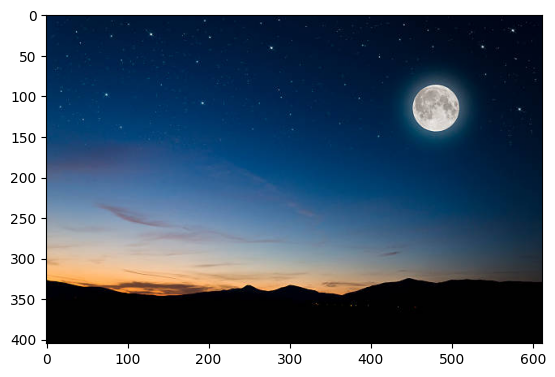

In [307]:
image_target_night = imread('night.jpeg')
plt.imshow(image_target_night)
# mean and covariance of sunset using MLE
pixelsN = image_target_night.reshape(-1,3) / 256 # normalizing to be between [0,1]
pixels_torchN = torch.Tensor(pixelsN) 
meanN_target = torch.mean(pixels_torchN , dim=0)
data_centeredN = pixels_torchN  - meanN_target
covarianceN_target = torch.matmul(data_centeredN.T, data_centeredN) / (pixels_torchN.size(0) - 1)

print(meanN_target)
print(covarianceN_target)

Number of parameters: 27
Layers:
W torch.Size([3, 3])
V torch.Size([3, 3])
bL torch.Size([3])
biases.0 torch.Size([3])
biases.1 torch.Size([3])


epoch 0 loss 206.5187530517578
tensor(7.0903)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


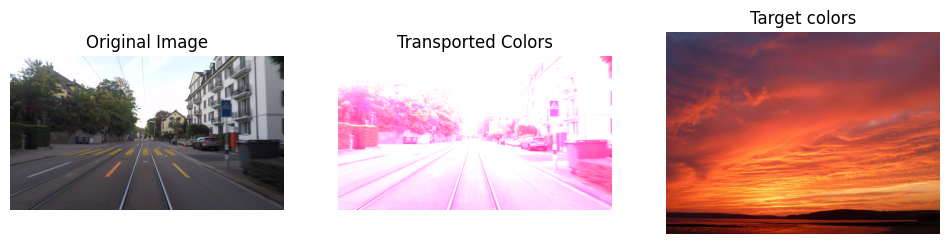

epoch 100 loss 5.071866989135742
tensor(5.7817)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


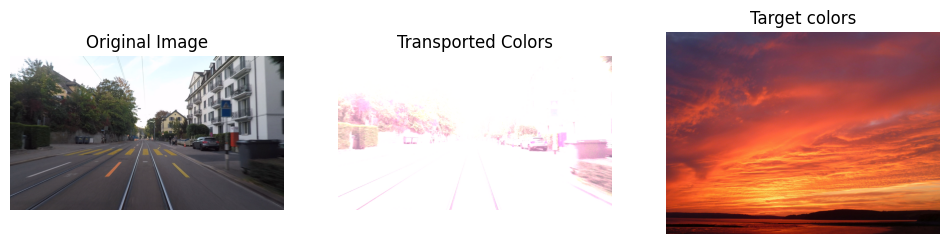

epoch 200 loss 4.069398880004883
tensor(4.9550)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


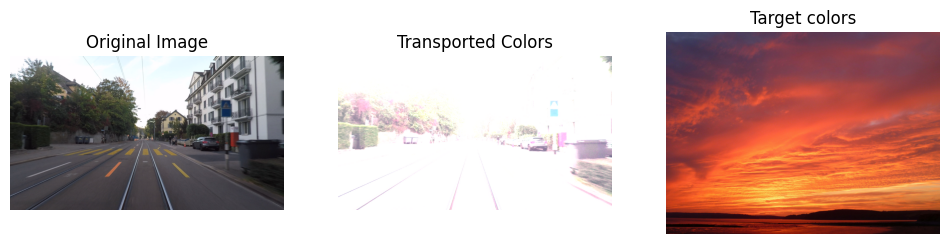

epoch 300 loss 3.254150629043579
tensor(4.1169)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


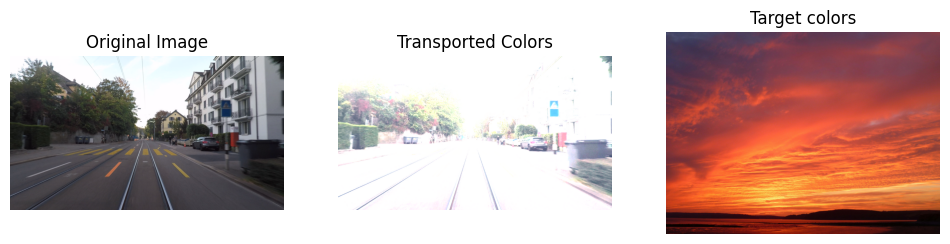

epoch 400 loss 2.3116464614868164
tensor(3.3813)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


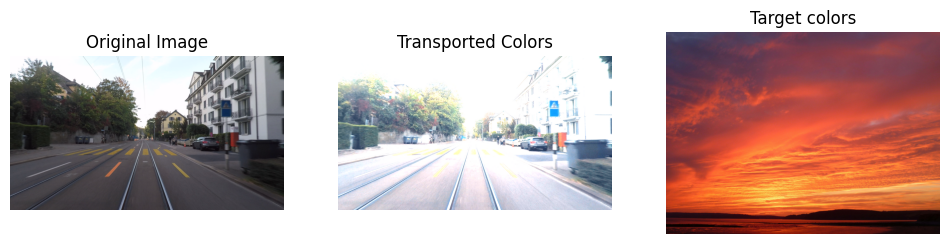

epoch 500 loss 1.2656604051589966
tensor(2.6276)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


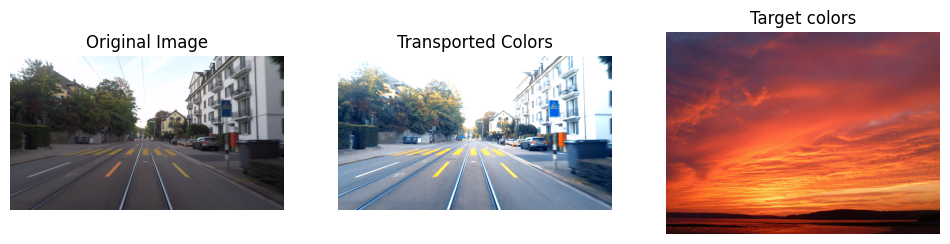

epoch 600 loss 0.4385525584220886
tensor(1.8498)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


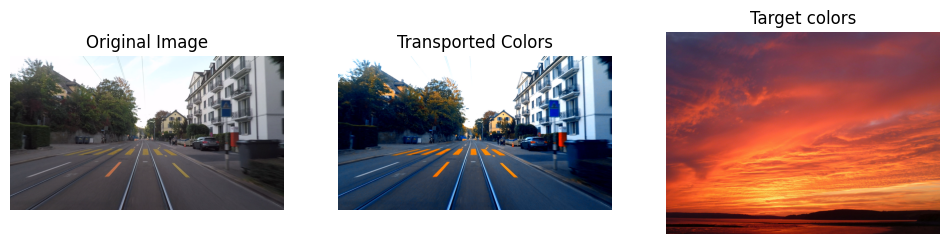

epoch 700 loss 0.10568985342979431
tensor(1.4452)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


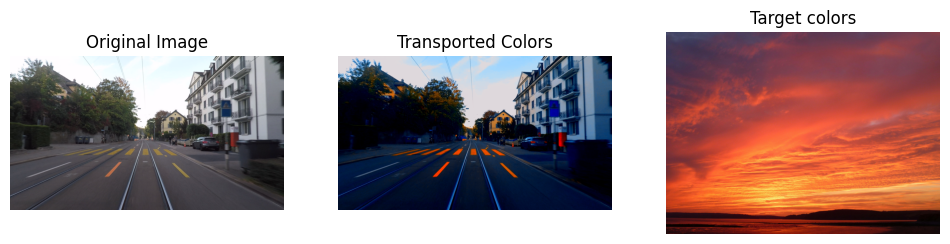

epoch 800 loss 0.03885659575462341
tensor(1.3716)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


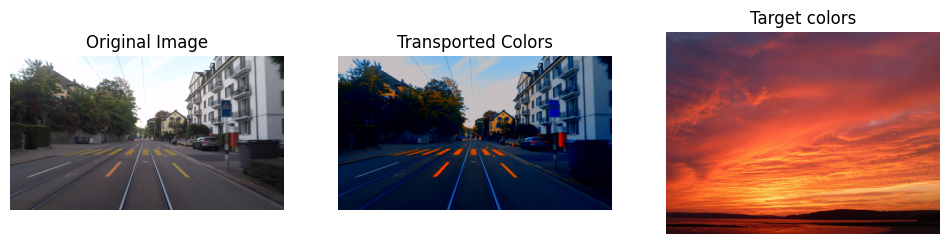

epoch 900 loss 0.020670369267463684
tensor(1.3604)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


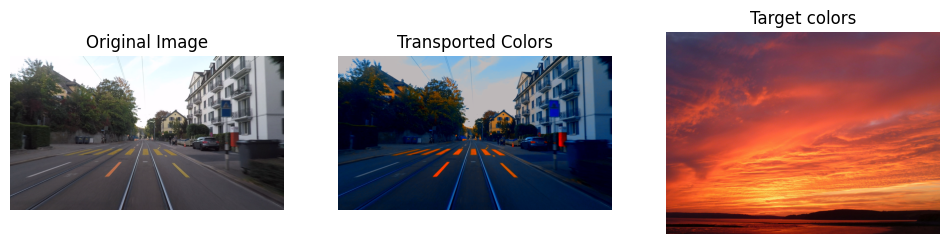

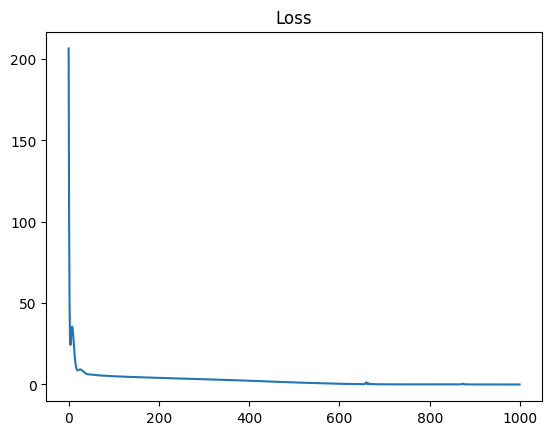

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

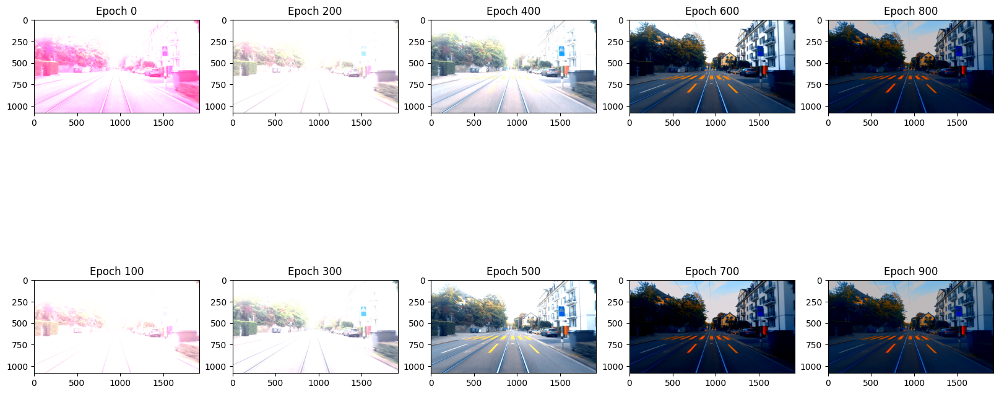

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(1.3419)


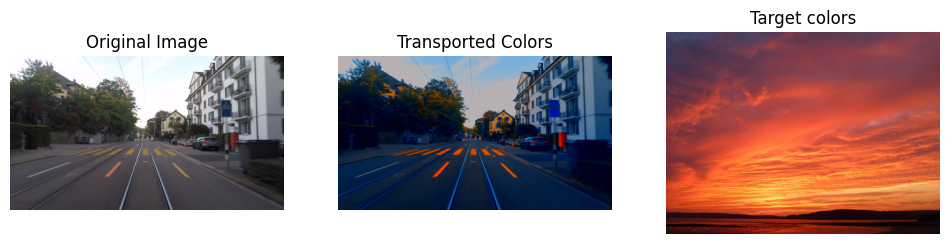

In [312]:
model_CMGN_night = None 
model_CMGN_night = CMGN(input_dim=3, output_dim=3, num_layers=2, hidden_dim=3)
summary_model(model_CMGN_night)
epochs = 1000

history_cmgn_night, nll_cmgn_night = train_color(model_CMGN_night, image_source, pixelS_torch, meanN_target, covarianceN_target,lr=0.02,num_epochs=epochs, viz=True)
plot_color_history(history_cmgn_night,epochs)
_= visualize_color_transport(model_CMGN_night,image_source,pixelS_torch, viz=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(2.2797)


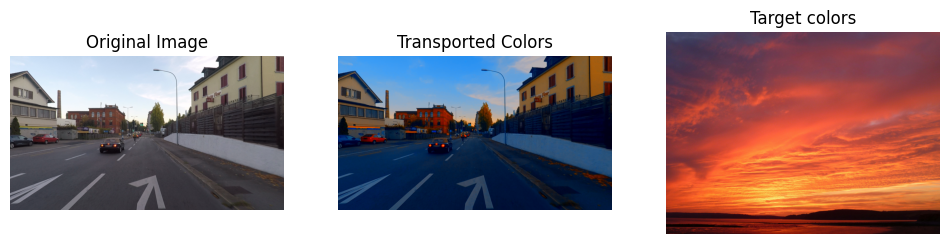

In [313]:
# apply on another image 
image2 = imread('dark_zurich/GOPR0356_frame_000375_ref_rgb_anon.png')
pixel2_torch = torch.Tensor(image2.reshape(-1,3)) 
_ = visualize_color_transport(model_CMGN_night,image2, pixel2_torch, viz=True)

epoch 0 loss 0.0021411366760730743
tensor(1.3870)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


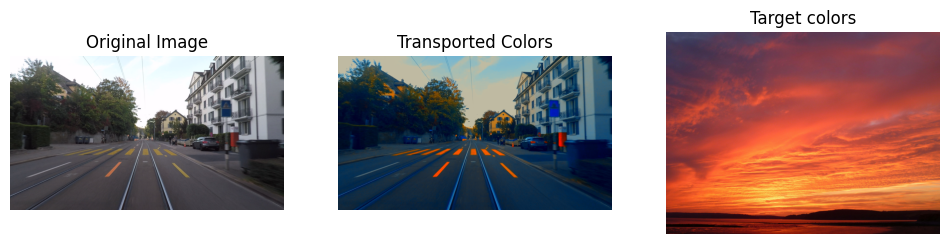

epoch 100 loss 0.03216575086116791
tensor(1.3550)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


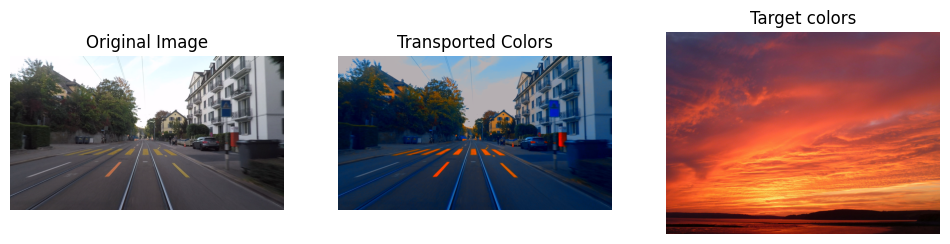

epoch 200 loss 0.00883270800113678
tensor(1.3373)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


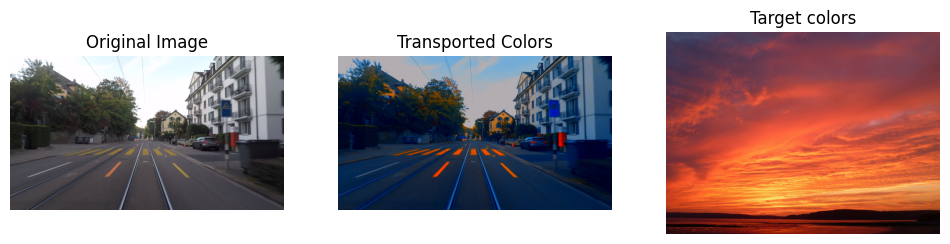

epoch 300 loss 0.0014183670282363892
tensor(1.3350)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


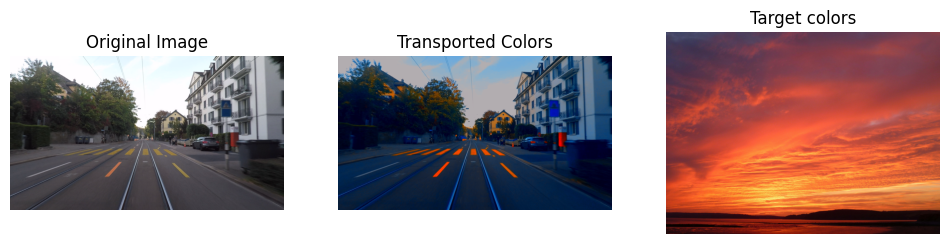

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch 400 loss 0.0001253308728337288
tensor(1.3330)


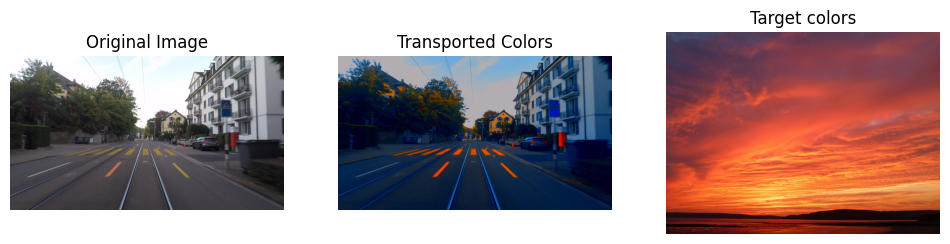

epoch 500 loss 1.2015923857688904e-05
tensor(1.3319)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


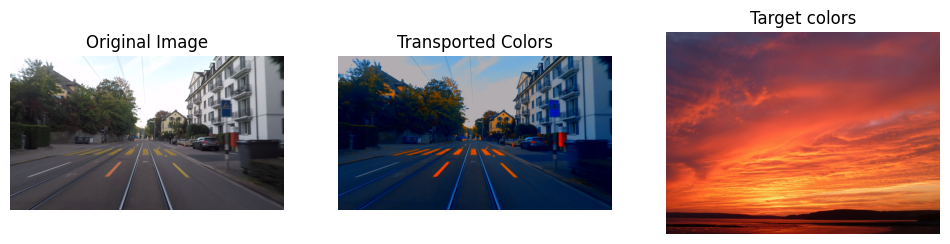

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch 600 loss 3.484543412923813e-06
tensor(1.3315)


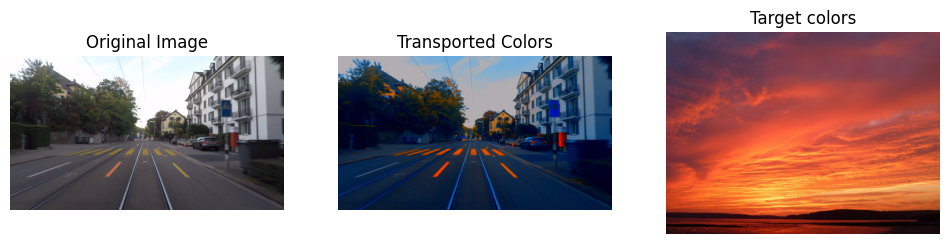

epoch 700 loss -2.280488843098283e-06
tensor(1.3315)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


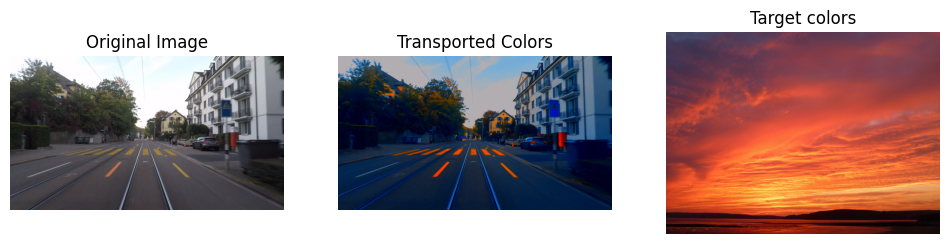

epoch 800 loss 4.161774995736778e-07
tensor(1.3314)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


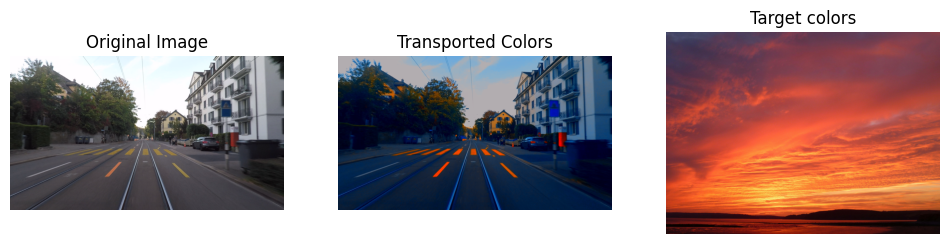

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch 900 loss 4.59462171420455e-07
tensor(1.3314)


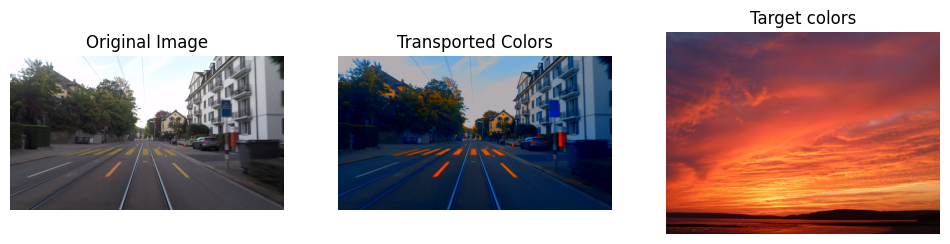

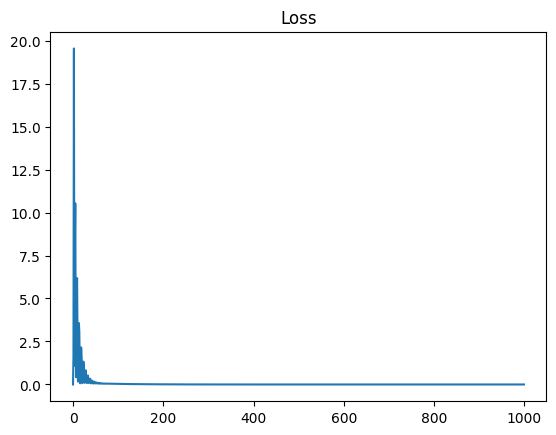

In [314]:
# keep training
history_cmgn_night2, nll_cmgn_night2 = train_color(model_CMGN_night, image_source, pixelS_torch, meanN_target, covarianceN_target,lr=0.02,num_epochs=epochs, viz=True)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

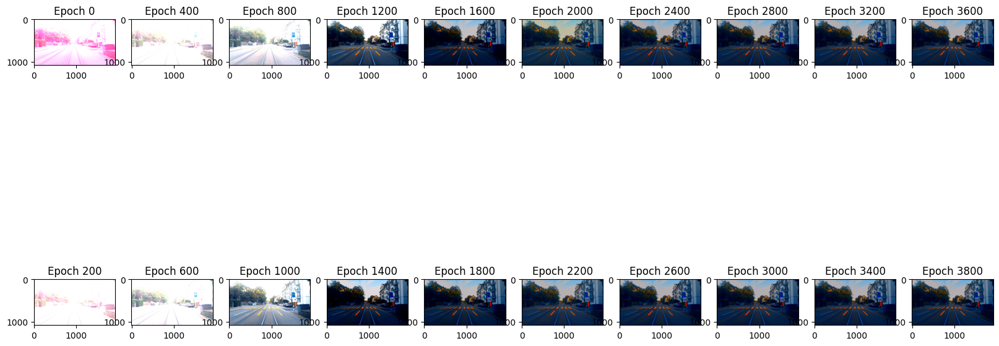

In [317]:
plot_color_history(history_cmgn_night+history_cmgn_night2,2000)

tensor(2.2707)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


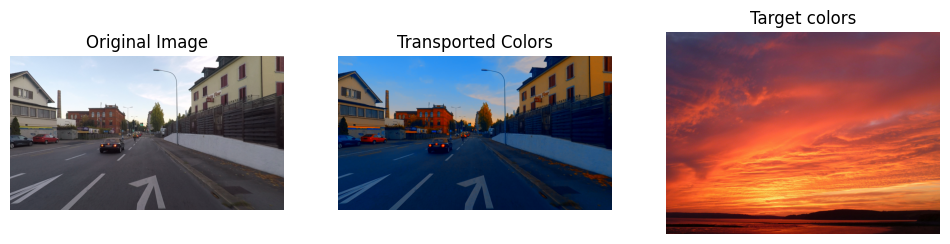

In [315]:
# apply on another image 
image2 = imread('dark_zurich/GOPR0356_frame_000375_ref_rgb_anon.png')
pixel2_torch = torch.Tensor(image2.reshape(-1,3)) 
_ = visualize_color_transport(model_CMGN_night,image2, pixel2_torch, viz=True)